# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [25]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(),y.float()),dim=1)
    #### END CODE HERE ####
    return combined

In [26]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
print(combined)
print(torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

tensor([[1., 2., 5., 6.],
        [3., 4., 7., 8.]])
tensor([[1, 2, 5, 6],
        [3, 4, 7, 8]])
Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [27]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [28]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [29]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [30]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [31]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.216563725233078, discriminator loss: 0.274798263952136


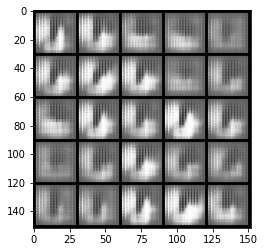

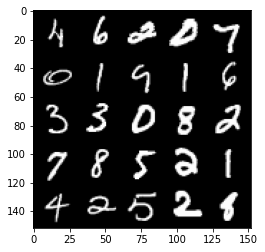

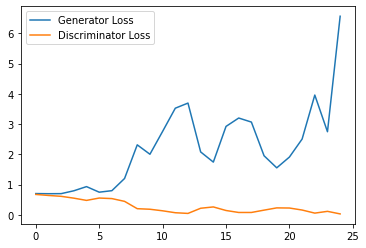

Step 1000: Generator loss: 4.166431636333465, discriminator loss: 0.04062549082003534


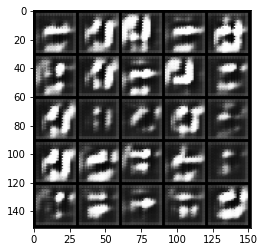

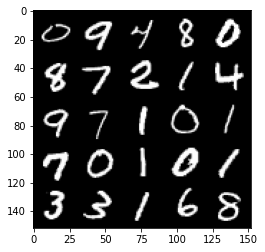

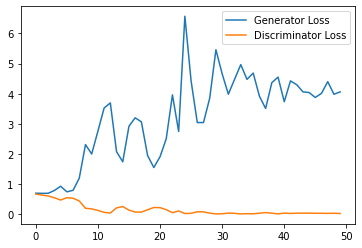

Step 1500: Generator loss: 4.051968739032746, discriminator loss: 0.0658093197401613


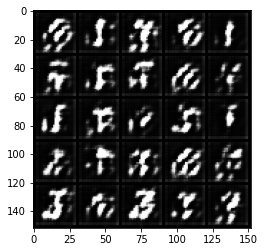

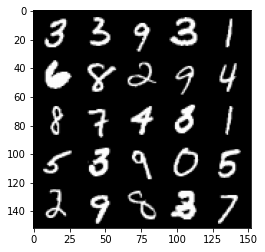

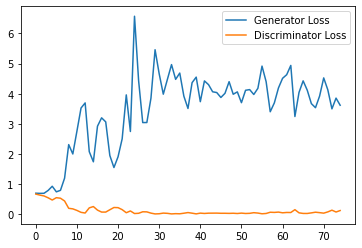

Step 2000: Generator loss: 2.8781288022994995, discriminator loss: 0.17633516557514667


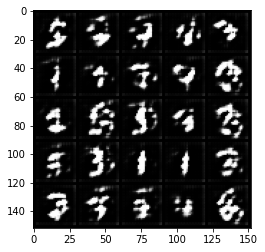

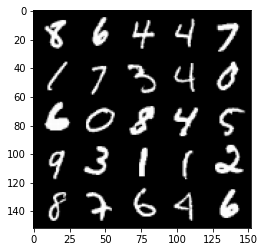

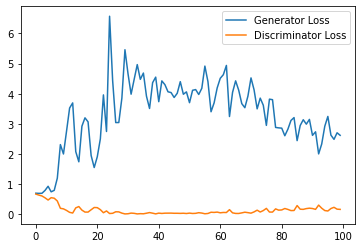

Step 2500: Generator loss: 2.425044245958328, discriminator loss: 0.248617082670331


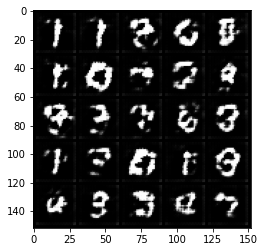

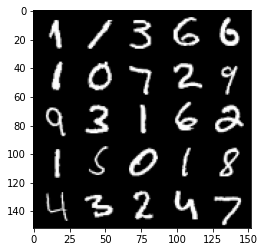

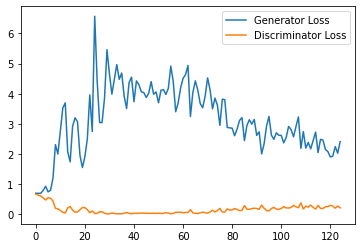

Step 3000: Generator loss: 2.2142406198978426, discriminator loss: 0.2816724825203419


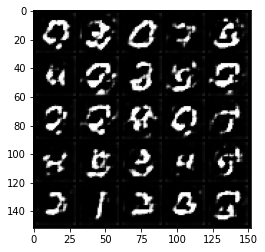

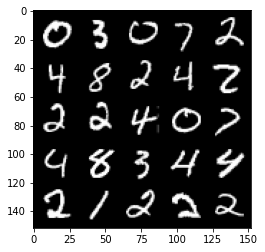

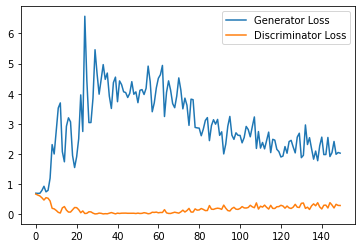

Step 3500: Generator loss: 2.050613888502121, discriminator loss: 0.31584379175305366


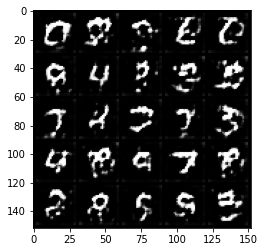

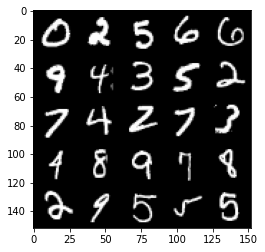

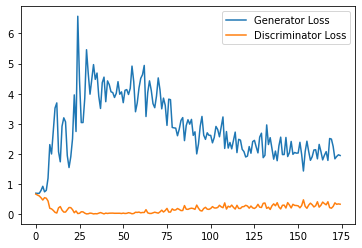

Step 4000: Generator loss: 2.0479363305568694, discriminator loss: 0.3278928706347942


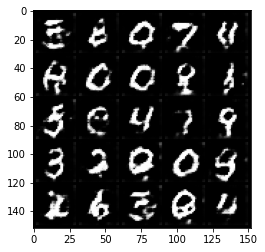

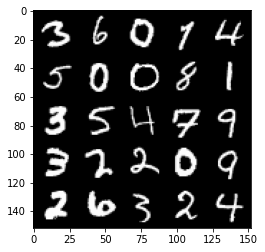

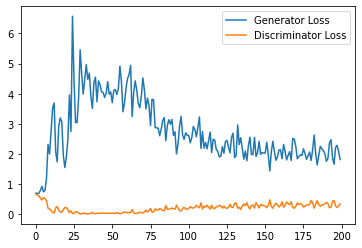

Step 4500: Generator loss: 1.9530638748407363, discriminator loss: 0.3393377908170223


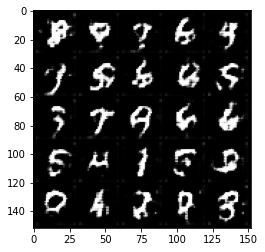

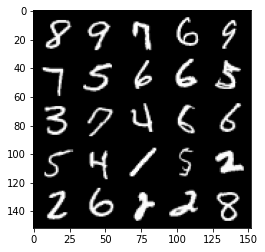

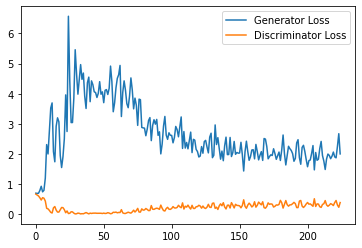

Step 5000: Generator loss: 1.9905972902774811, discriminator loss: 0.3731790276169777


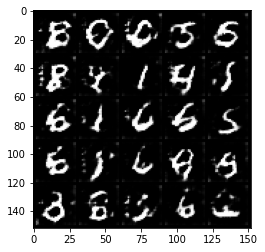

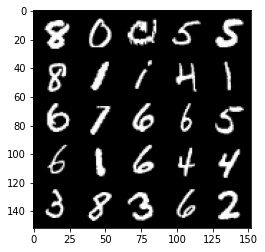

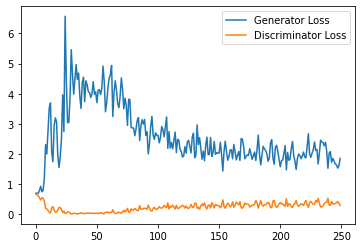

Step 5500: Generator loss: 1.7087643599510194, discriminator loss: 0.3779958970248699


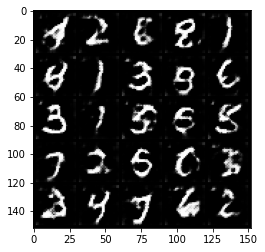

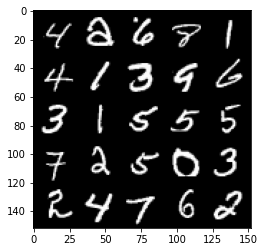

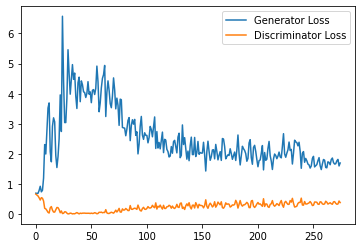

Step 6000: Generator loss: 1.7356495945453643, discriminator loss: 0.4113116773366928


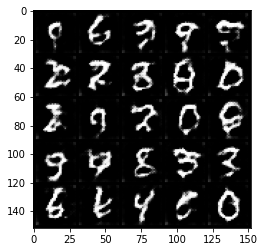

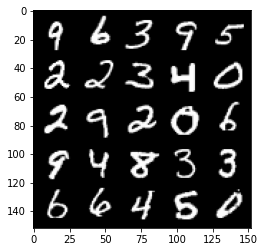

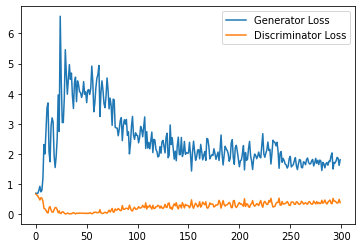

Step 6500: Generator loss: 1.645371265411377, discriminator loss: 0.44178548488020897


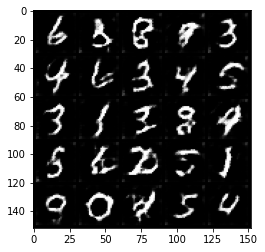

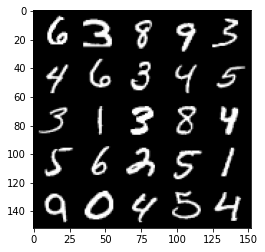

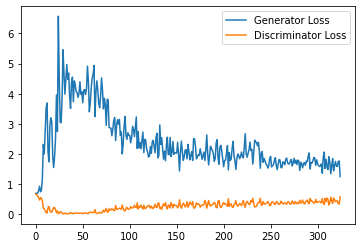

Step 7000: Generator loss: 1.460118467092514, discriminator loss: 0.45928276526927947


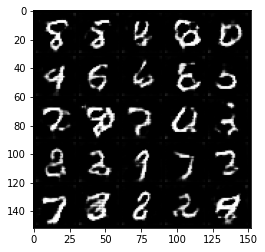

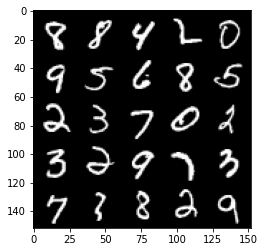

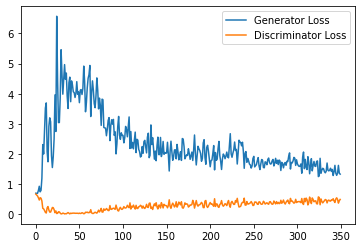

Step 7500: Generator loss: 1.42864708840847, discriminator loss: 0.4886402650475502


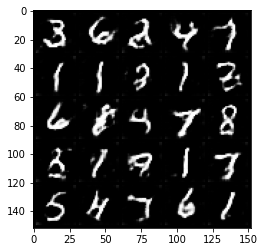

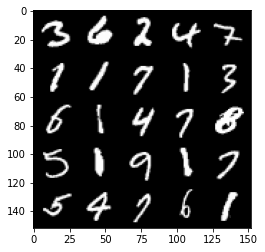

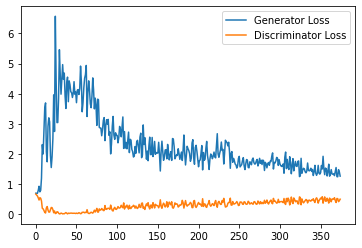

Step 8000: Generator loss: 1.4116366566419603, discriminator loss: 0.49162960815429685


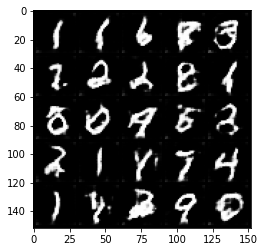

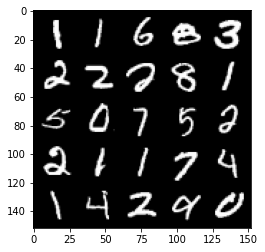

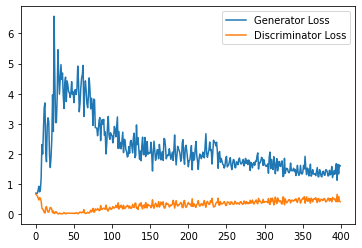

Step 8500: Generator loss: 1.3745445204973221, discriminator loss: 0.5033438078761101


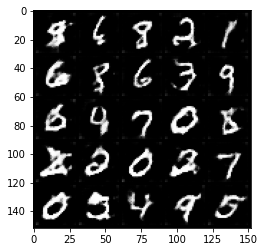

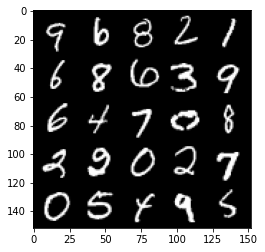

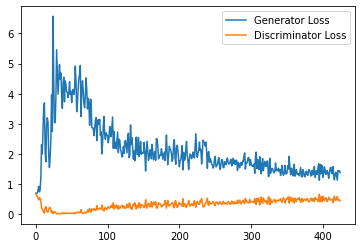

Step 9000: Generator loss: 1.353895050048828, discriminator loss: 0.507279846072197


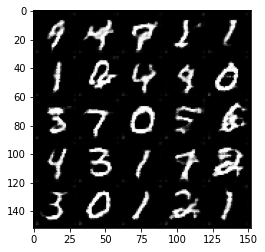

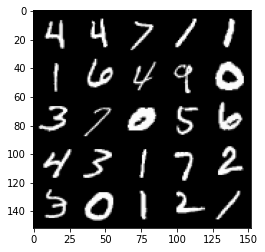

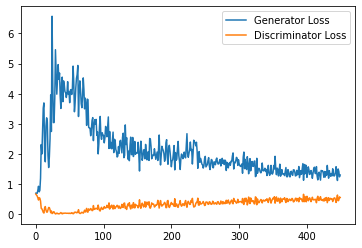

Step 9500: Generator loss: 1.3789127502441407, discriminator loss: 0.5018083176016808


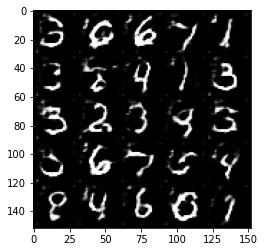

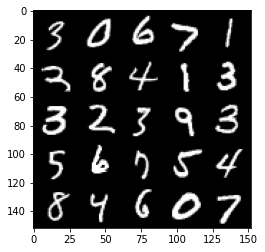

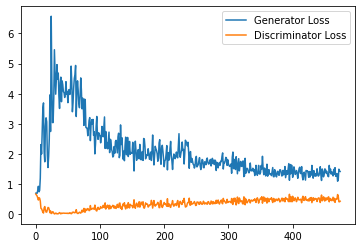

Step 10000: Generator loss: 1.3347737481594086, discriminator loss: 0.5144361006617546


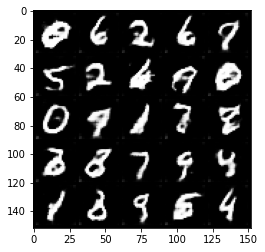

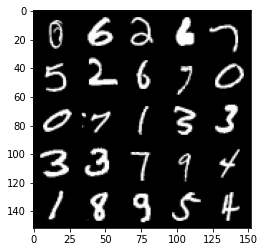

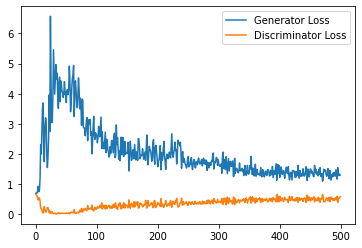

Step 10500: Generator loss: 1.2793003587722778, discriminator loss: 0.5118271617293357


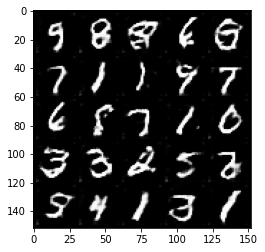

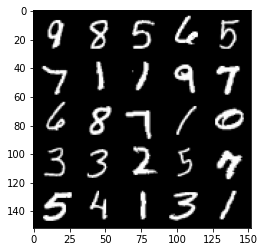

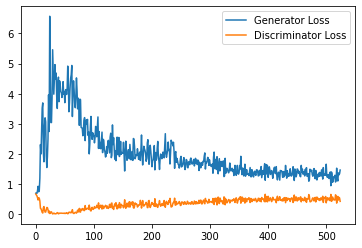

Step 11000: Generator loss: 1.258913630247116, discriminator loss: 0.5266229280233383


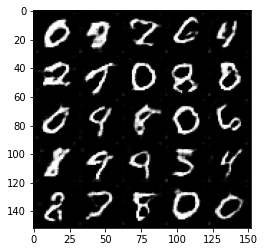

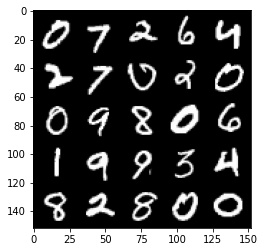

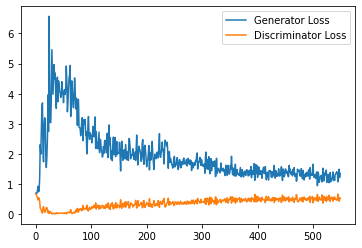

Step 11500: Generator loss: 1.24056057035923, discriminator loss: 0.536428488612175


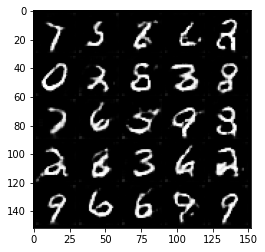

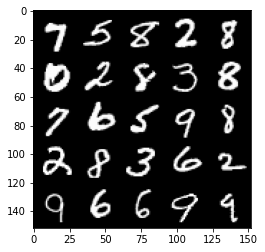

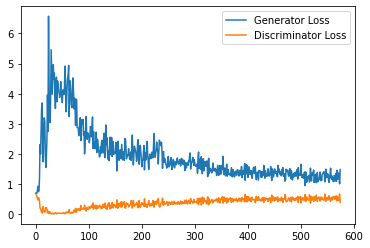

Step 12000: Generator loss: 1.2664040200710296, discriminator loss: 0.5333743122816086


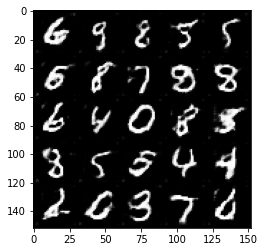

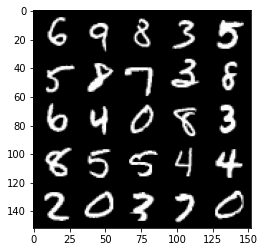

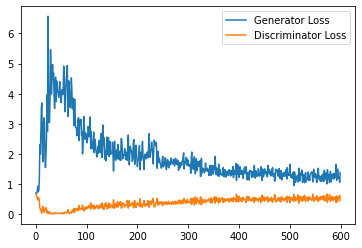

Step 12500: Generator loss: 1.240281093597412, discriminator loss: 0.5353897519111633


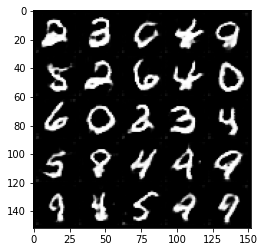

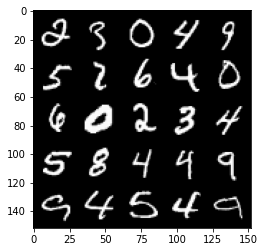

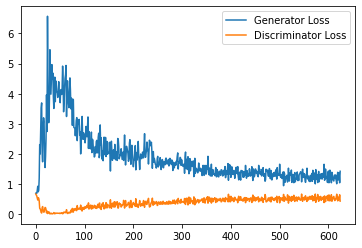

Step 13000: Generator loss: 1.2167311074733733, discriminator loss: 0.5370354113578797


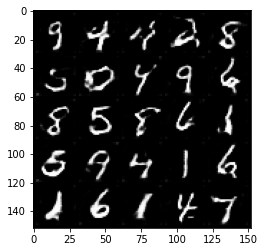

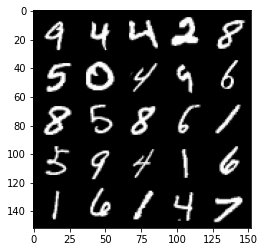

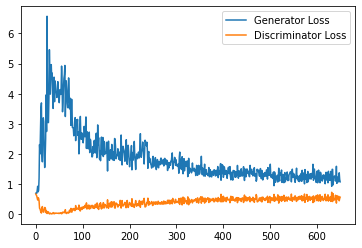

Step 13500: Generator loss: 1.1804535779953003, discriminator loss: 0.5387121453881264


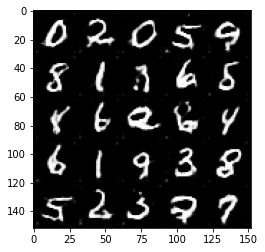

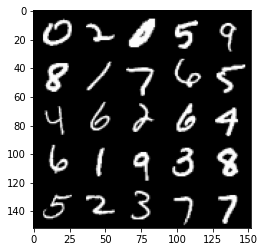

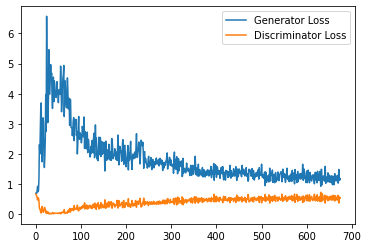

Step 14000: Generator loss: 1.1804389805793762, discriminator loss: 0.541257422208786


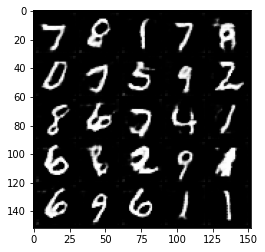

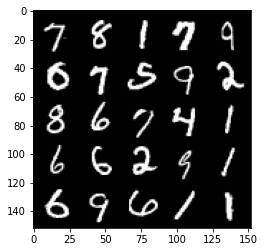

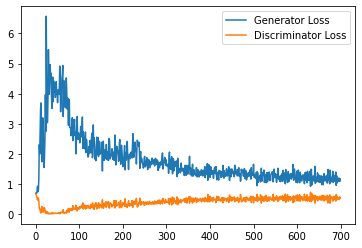

Step 14500: Generator loss: 1.2237690262794494, discriminator loss: 0.5412579941749572


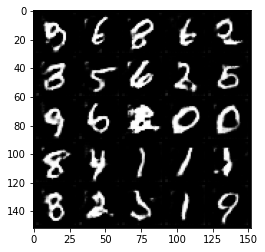

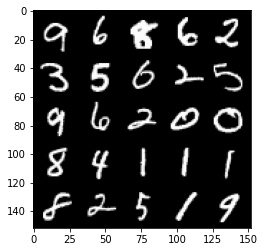

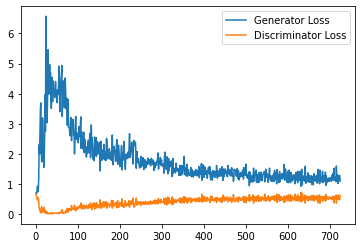

Step 15000: Generator loss: 1.1836337463855744, discriminator loss: 0.5394015744328499


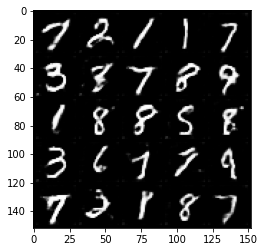

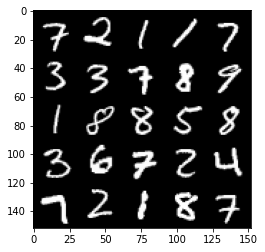

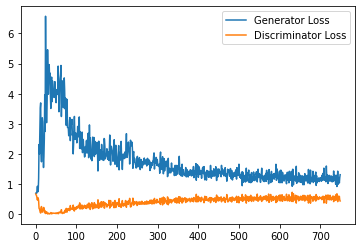

Step 15500: Generator loss: 1.173498997926712, discriminator loss: 0.5517178322672844


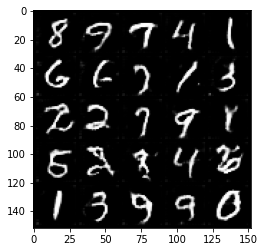

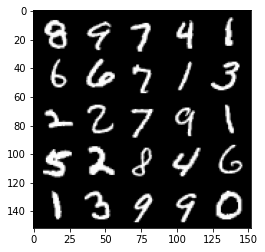

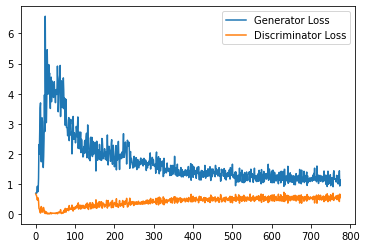

Step 16000: Generator loss: 1.1683041285276412, discriminator loss: 0.5502311808466911


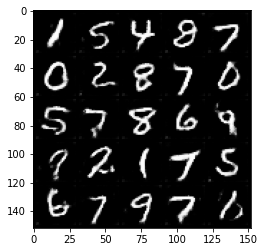

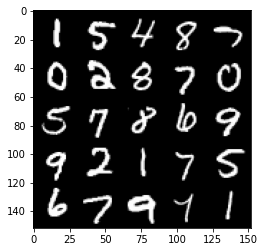

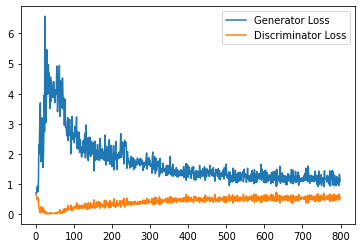

Step 16500: Generator loss: 1.1823438864946365, discriminator loss: 0.5452808713316918


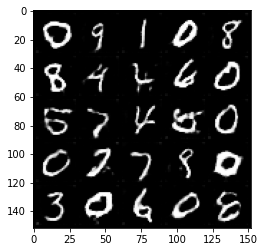

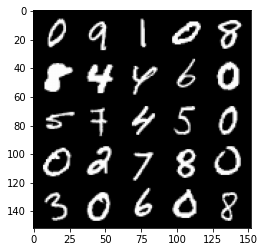

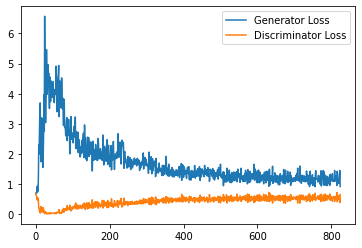

Step 17000: Generator loss: 1.1234157458543776, discriminator loss: 0.5547072058916092


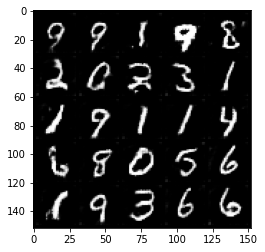

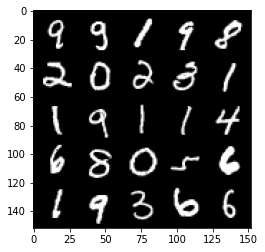

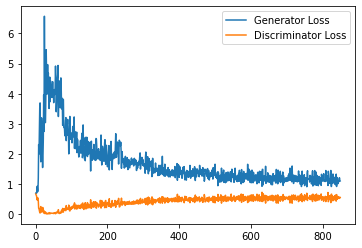

Step 17500: Generator loss: 1.1771923884153366, discriminator loss: 0.5408584576845169


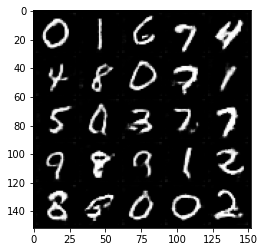

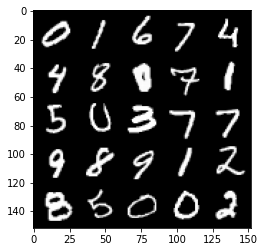

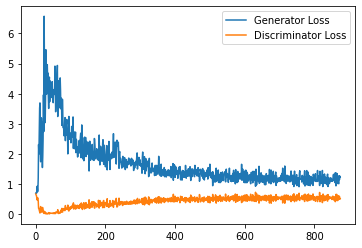

Step 18000: Generator loss: 1.1327028735876083, discriminator loss: 0.5495480550527573


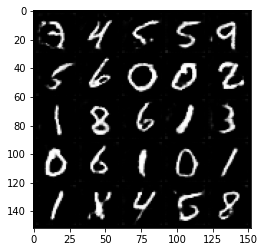

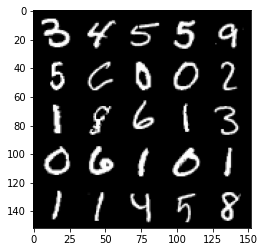

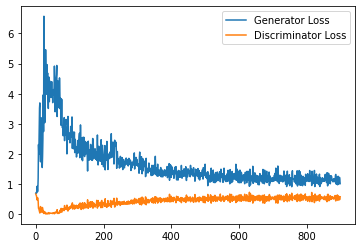

Step 18500: Generator loss: 1.128846004843712, discriminator loss: 0.5502533764839173


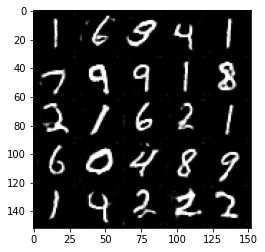

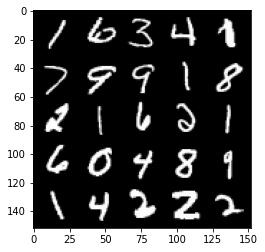

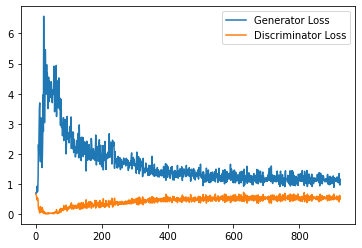

Step 19000: Generator loss: 1.1200226284265518, discriminator loss: 0.5552156695127487


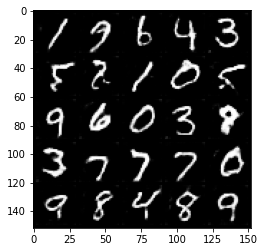

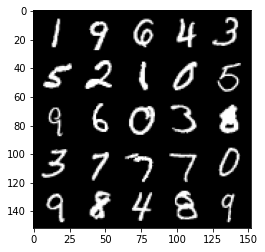

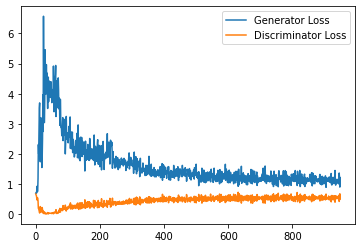

Step 19500: Generator loss: 1.1423377841711044, discriminator loss: 0.5527684850692749


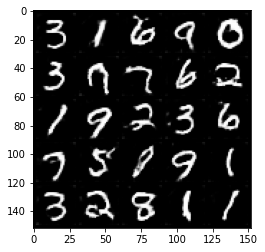

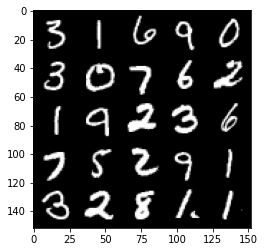

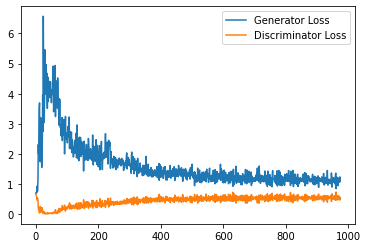

Step 20000: Generator loss: 1.1442749027013779, discriminator loss: 0.5572688317894936


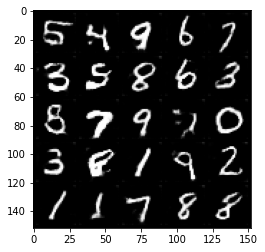

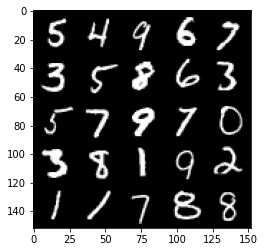

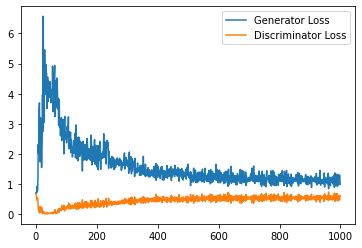

Step 20500: Generator loss: 1.1008063907623291, discriminator loss: 0.5599355135560036


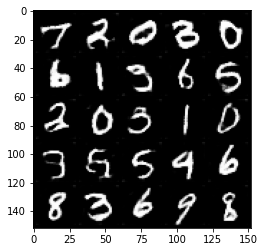

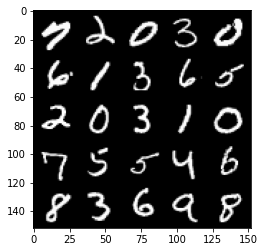

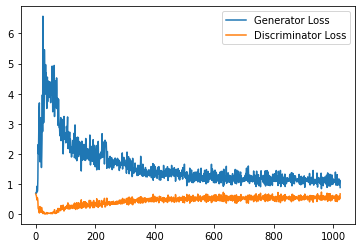

Step 21000: Generator loss: 1.1151349201202392, discriminator loss: 0.5518563275933266


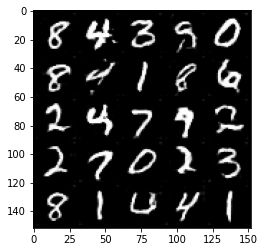

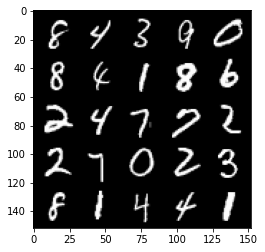

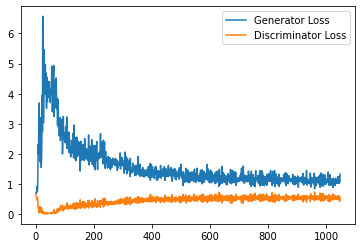

Step 21500: Generator loss: 1.0989230566024781, discriminator loss: 0.5610491286516189


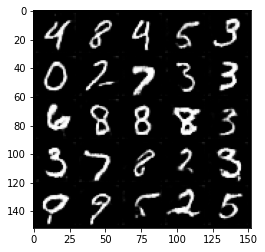

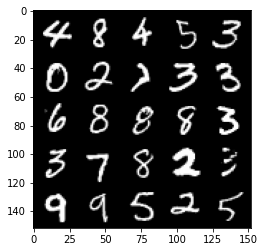

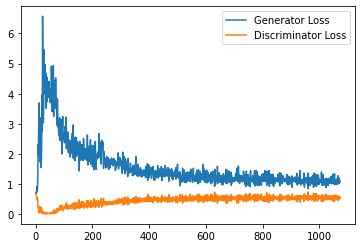

Step 22000: Generator loss: 1.104251203417778, discriminator loss: 0.5605556614995003


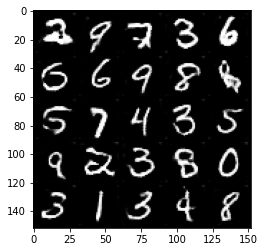

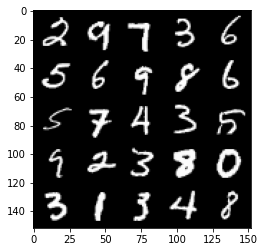

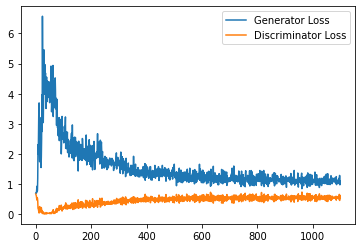

Step 22500: Generator loss: 1.0969392217397689, discriminator loss: 0.5622232251763344


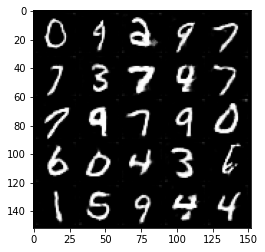

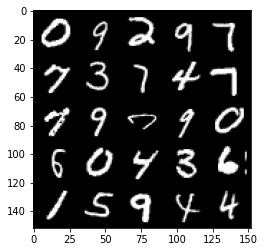

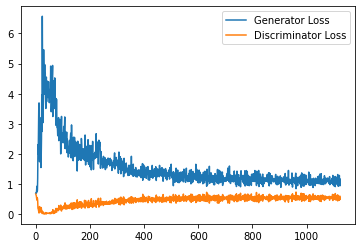

Step 23000: Generator loss: 1.0668714368343353, discriminator loss: 0.5683904964923858


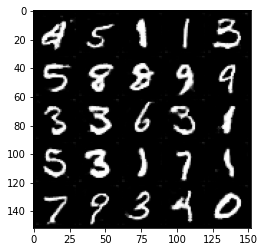

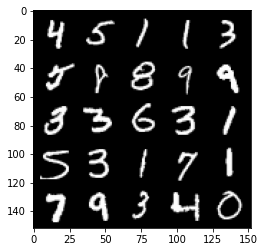

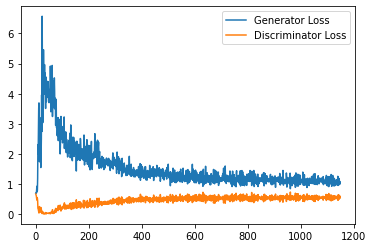

Step 23500: Generator loss: 1.0934379081726073, discriminator loss: 0.5659535841345787


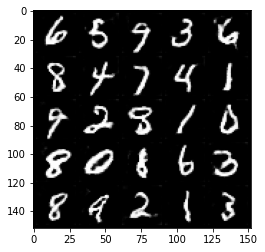

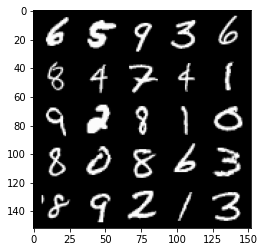

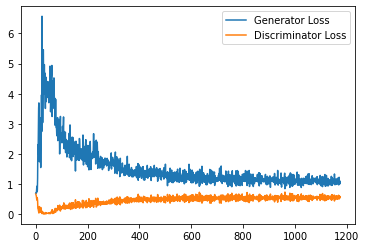

Step 24000: Generator loss: 1.1118820985555649, discriminator loss: 0.5664743672013283


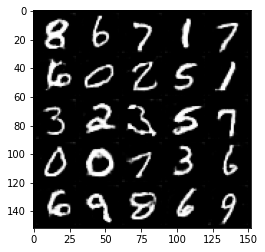

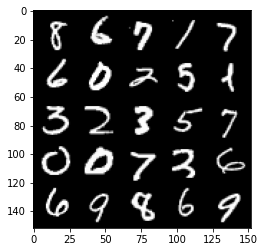

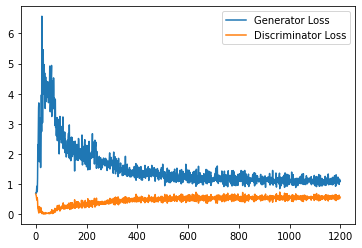

Step 24500: Generator loss: 1.0798904383182526, discriminator loss: 0.5668428366780282


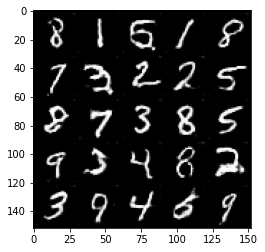

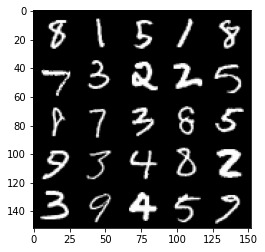

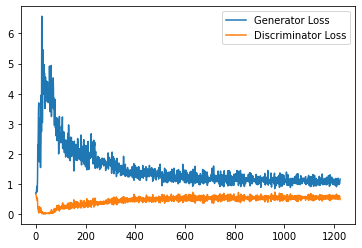

Step 25000: Generator loss: 1.0759774808883666, discriminator loss: 0.5692074127197265


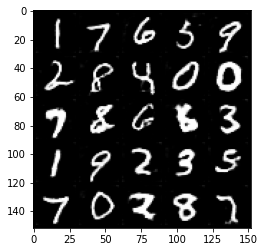

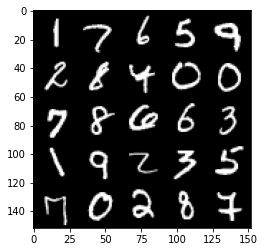

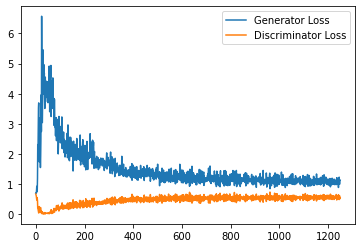

Step 25500: Generator loss: 1.083221006512642, discriminator loss: 0.5719864761829376


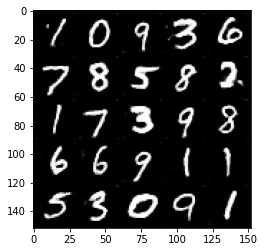

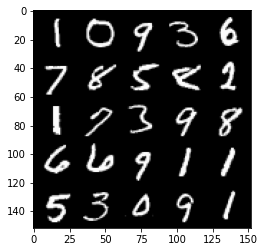

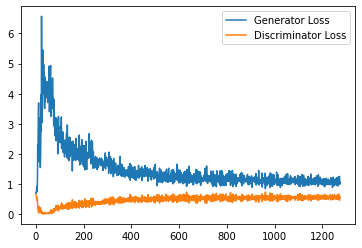

Step 26000: Generator loss: 1.0824410427808762, discriminator loss: 0.5673977150321007


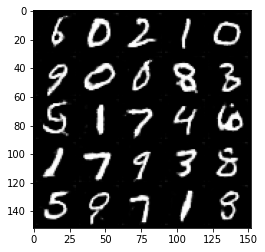

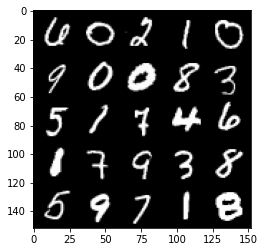

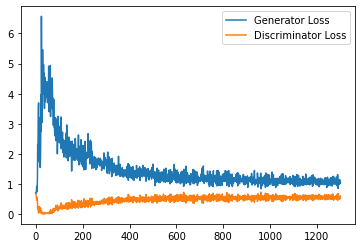

Step 26500: Generator loss: 1.0726212623119353, discriminator loss: 0.5686319845318795


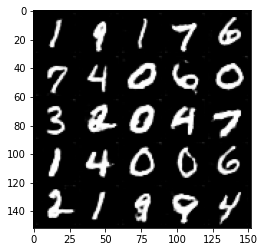

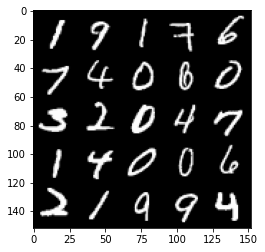

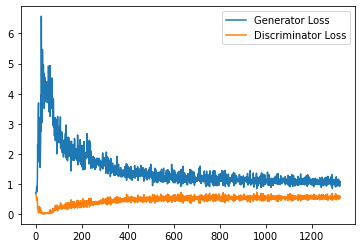

Step 27000: Generator loss: 1.0613564479351043, discriminator loss: 0.5756975442767144


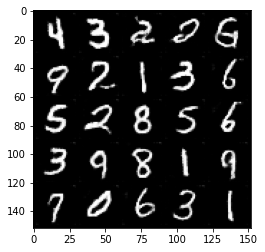

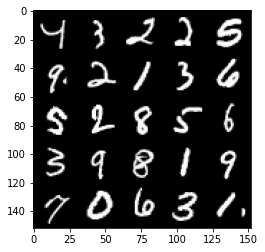

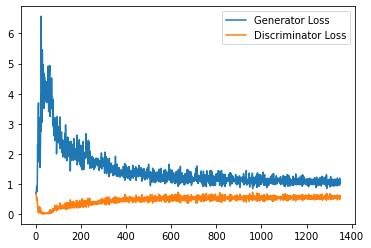

Step 27500: Generator loss: 1.0698738919496535, discriminator loss: 0.5731441150903702


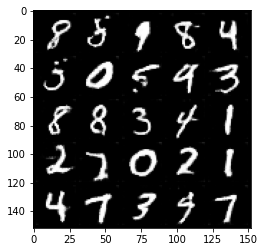

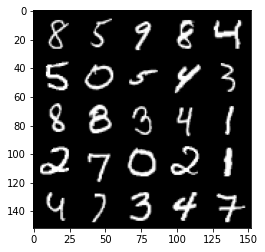

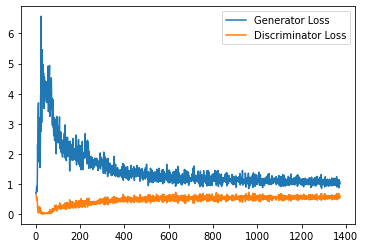

Step 28000: Generator loss: 1.0727934976816178, discriminator loss: 0.5708394383192062


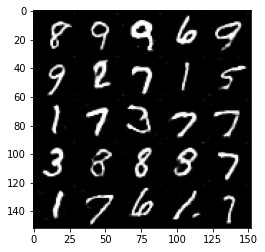

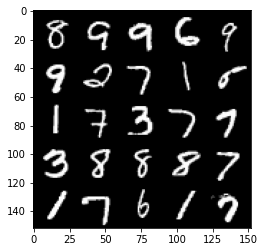

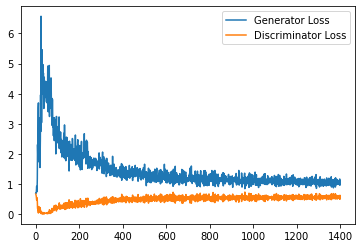

Step 28500: Generator loss: 1.0413725559711455, discriminator loss: 0.580078042447567


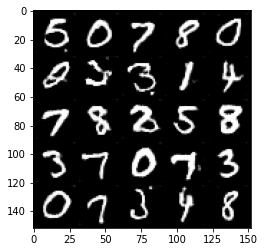

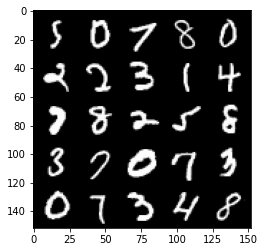

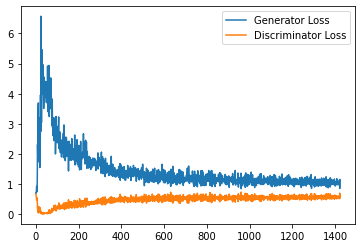

Step 29000: Generator loss: 1.0843939467668533, discriminator loss: 0.5796333128809928


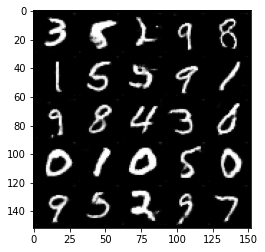

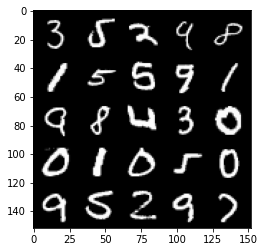

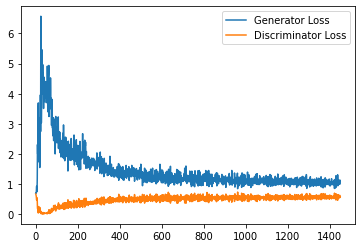

Step 29500: Generator loss: 1.0691752165555954, discriminator loss: 0.5756736753582954


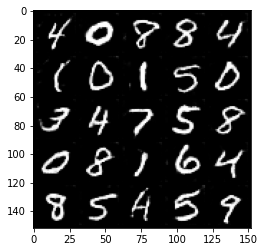

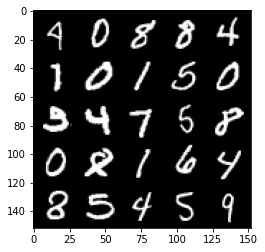

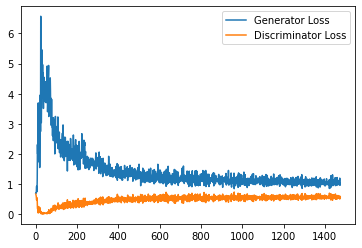

Step 30000: Generator loss: 1.0457583440542222, discriminator loss: 0.5773218315243721


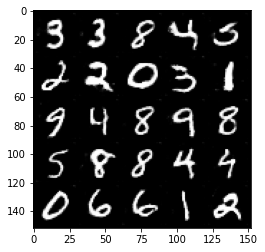

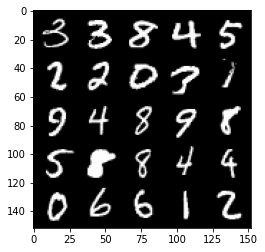

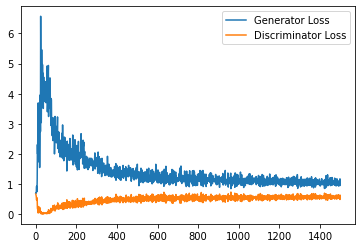

Step 30500: Generator loss: 1.0478284451961517, discriminator loss: 0.5827762661576271


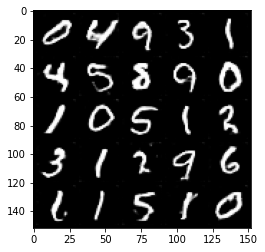

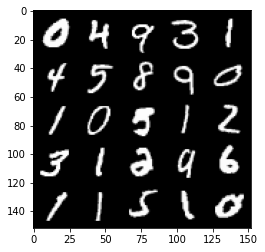

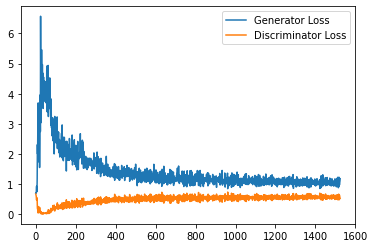

Step 31000: Generator loss: 1.0601398313045503, discriminator loss: 0.5835102508664132


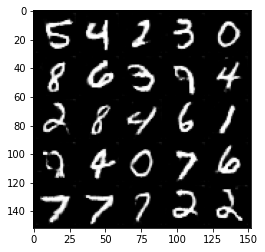

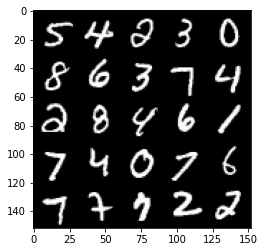

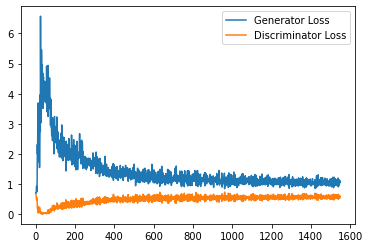

Step 31500: Generator loss: 1.0386531192064286, discriminator loss: 0.5792855087518692


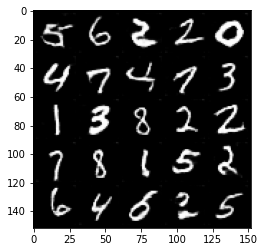

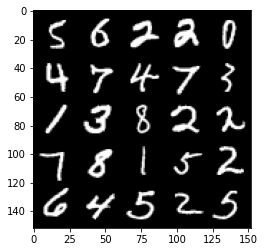

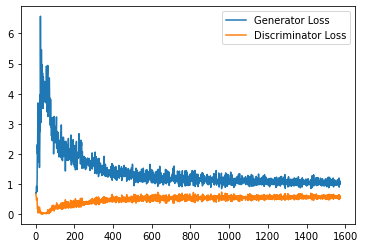

Step 32000: Generator loss: 1.0340276141166687, discriminator loss: 0.5800723859667778


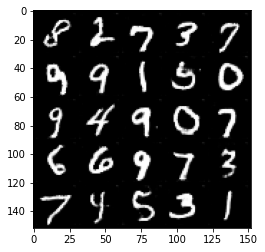

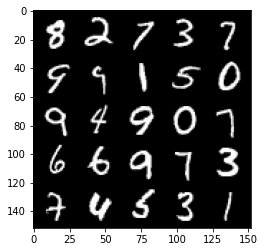

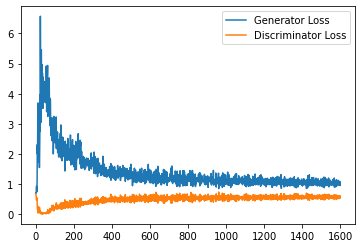

Step 32500: Generator loss: 1.0581506267786025, discriminator loss: 0.5777152603268624


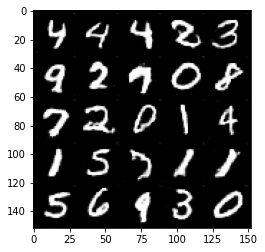

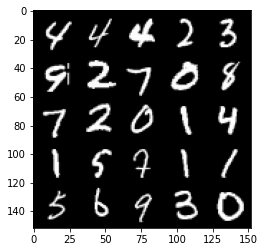

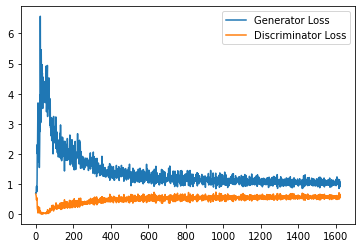

Step 33000: Generator loss: 1.0486820287704468, discriminator loss: 0.5794869588017464


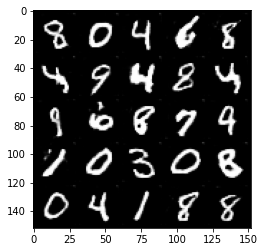

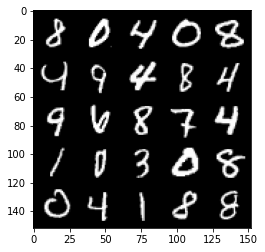

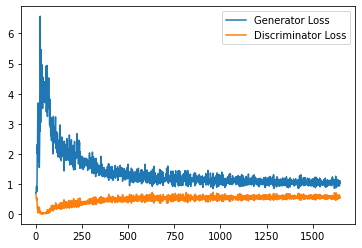

Step 33500: Generator loss: 1.0410769611597062, discriminator loss: 0.5796783920526505


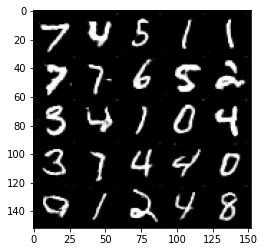

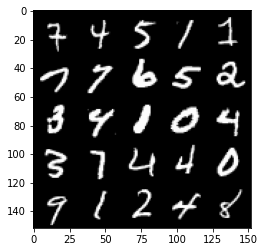

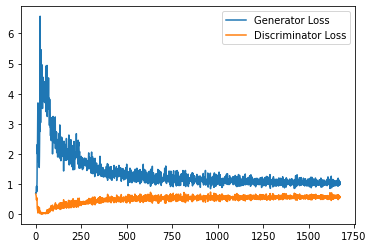

Step 34000: Generator loss: 1.0445179738998414, discriminator loss: 0.581115728378296


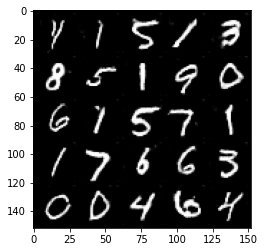

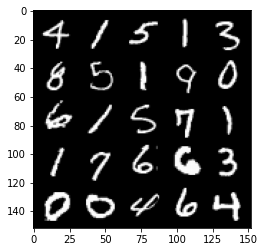

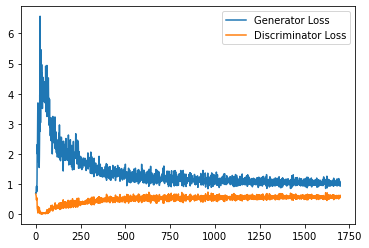

Step 34500: Generator loss: 1.0267336262464524, discriminator loss: 0.5820060412287712


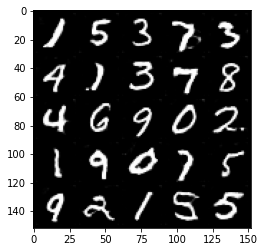

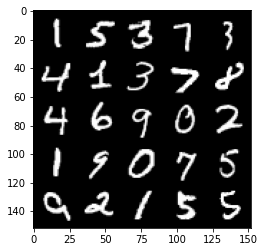

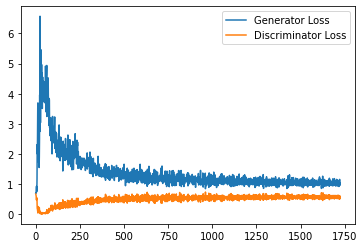

Step 35000: Generator loss: 1.0267516009807587, discriminator loss: 0.5799103834629059


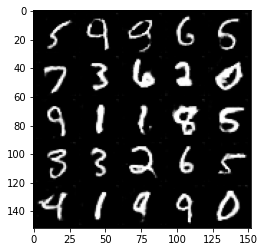

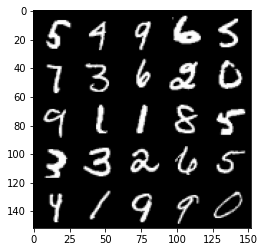

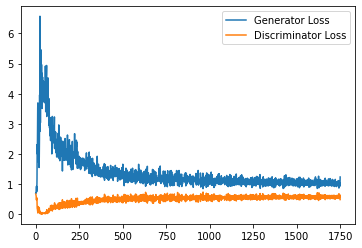

Step 35500: Generator loss: 1.0311720379590987, discriminator loss: 0.5886625865101814


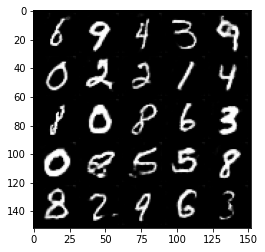

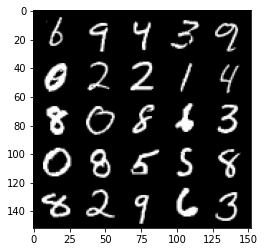

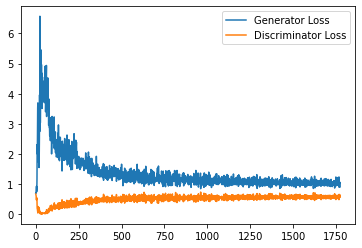

Step 36000: Generator loss: 1.0354424922466279, discriminator loss: 0.5807024597525596


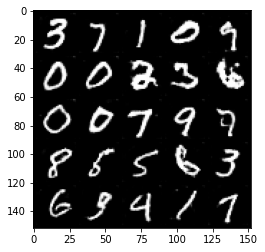

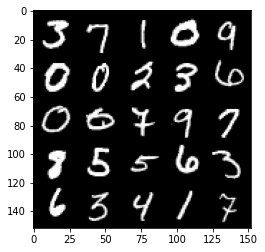

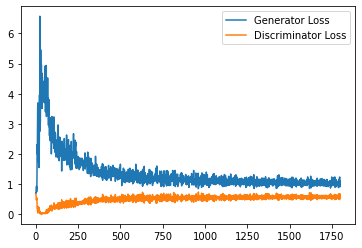

Step 36500: Generator loss: 1.047599694132805, discriminator loss: 0.5819346158504486


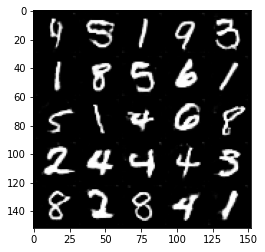

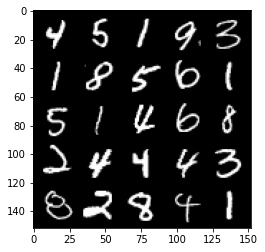

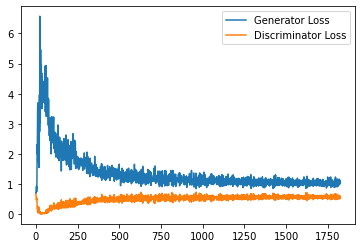

Step 37000: Generator loss: 1.03860879611969, discriminator loss: 0.5850231511592865


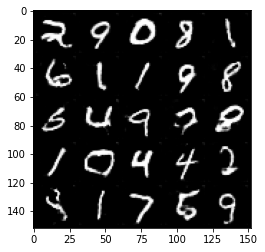

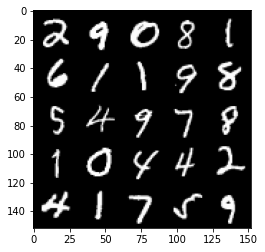

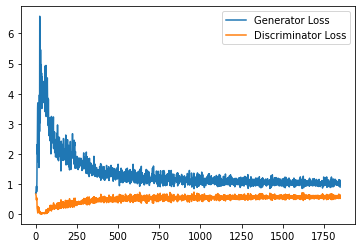

Step 37500: Generator loss: 1.0399686017036438, discriminator loss: 0.5823143218159675


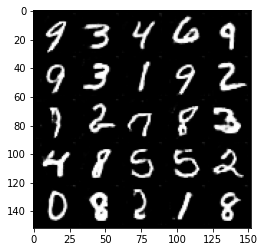

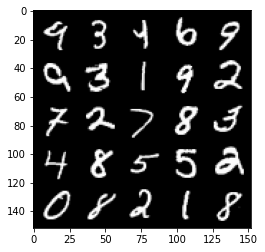

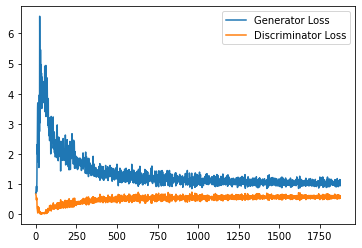

Step 38000: Generator loss: 1.036402935743332, discriminator loss: 0.5834994113445282


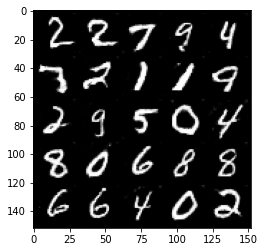

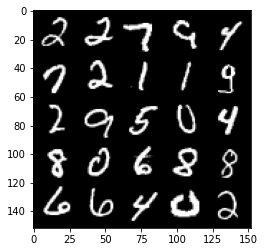

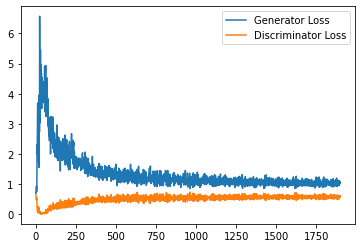

Step 38500: Generator loss: 1.0774877355098724, discriminator loss: 0.579696205496788


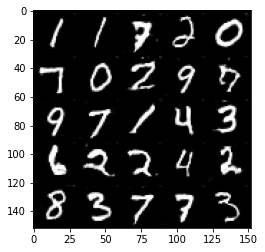

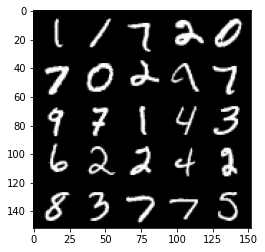

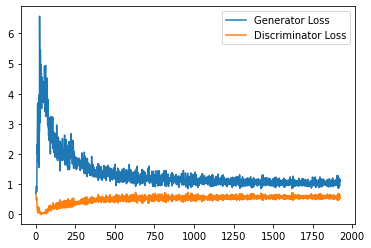

Step 39000: Generator loss: 1.073945266008377, discriminator loss: 0.584166262626648


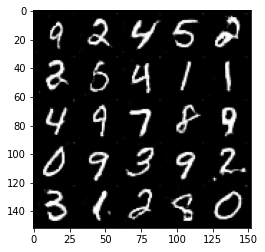

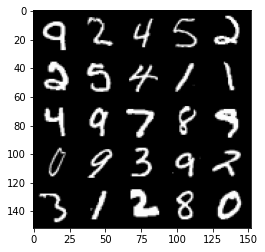

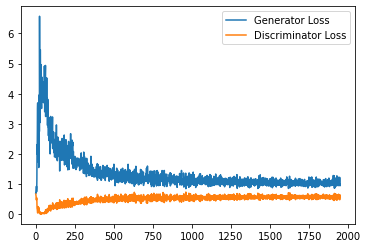

Step 39500: Generator loss: 1.0488107095956802, discriminator loss: 0.5814975875616074


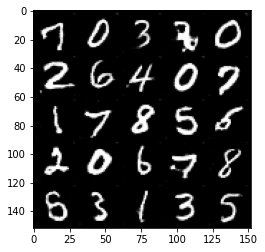

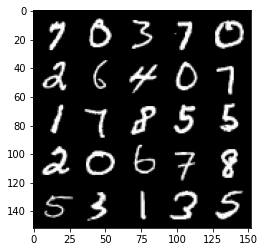

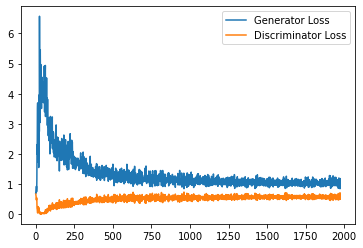

Step 40000: Generator loss: 1.0244652795791627, discriminator loss: 0.5825338611006736


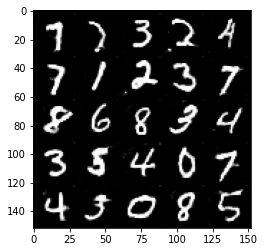

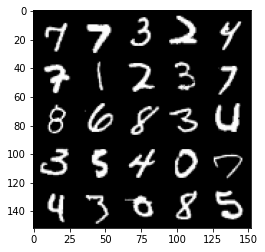

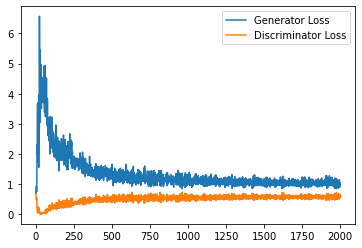

Step 40500: Generator loss: 1.0402577316761017, discriminator loss: 0.5771448900699615


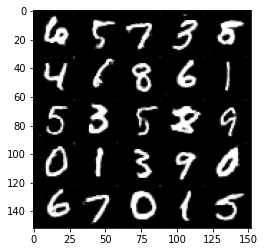

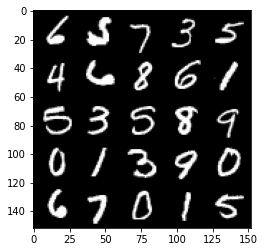

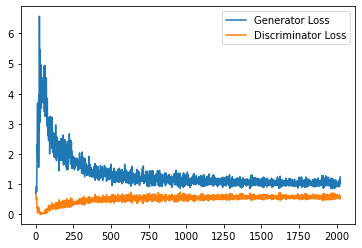

Step 41000: Generator loss: 1.0498605353832244, discriminator loss: 0.5846883289217949


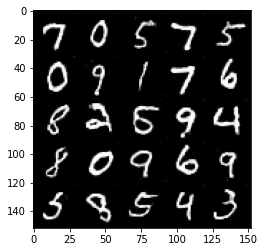

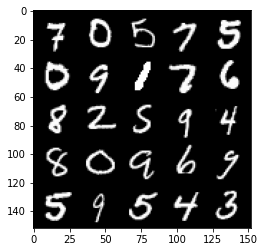

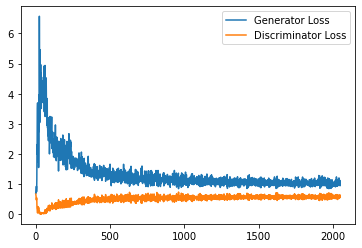

Step 41500: Generator loss: 1.0530357162952424, discriminator loss: 0.5775991224050522


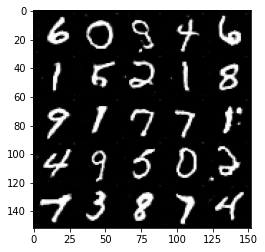

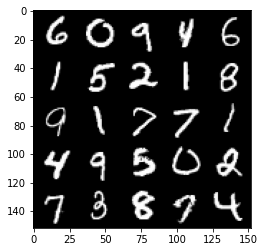

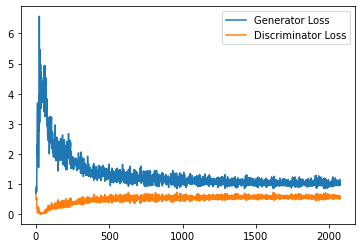

Step 42000: Generator loss: 1.0625599002838135, discriminator loss: 0.5704905053377152


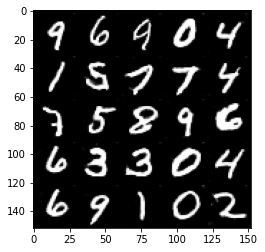

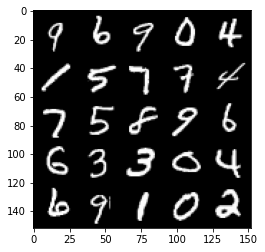

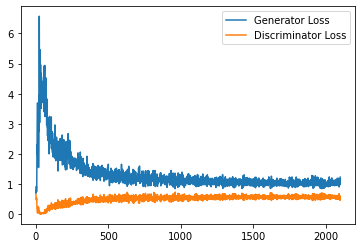

Step 42500: Generator loss: 1.0609856481552125, discriminator loss: 0.5757658631801605


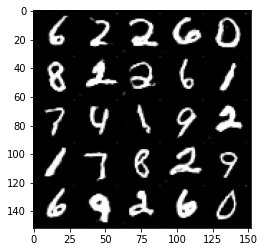

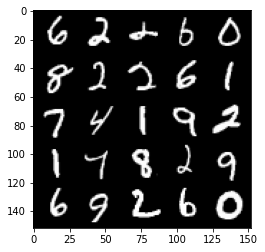

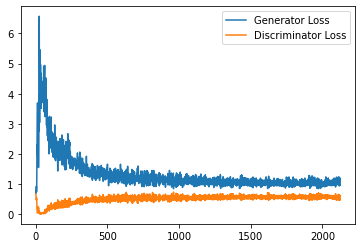

Step 43000: Generator loss: 1.041405331969261, discriminator loss: 0.5754975373744965


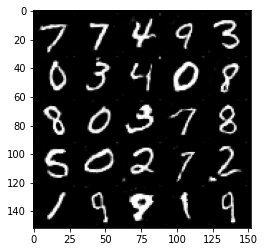

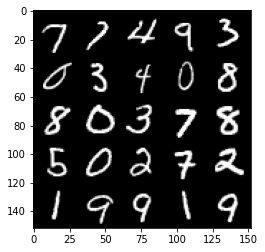

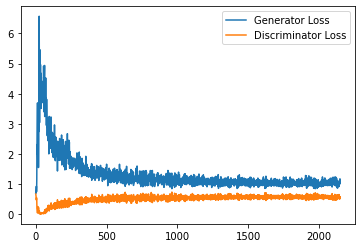

Step 43500: Generator loss: 1.0792817451953889, discriminator loss: 0.5727986374497414


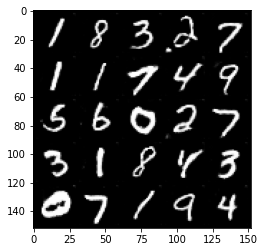

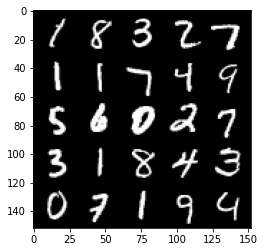

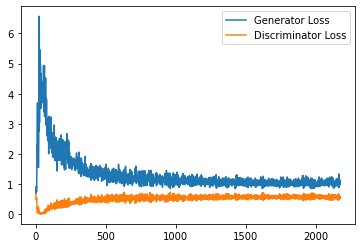

Step 44000: Generator loss: 1.039799772620201, discriminator loss: 0.5816058303713798


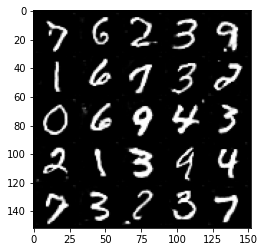

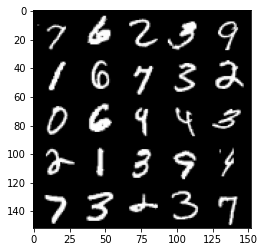

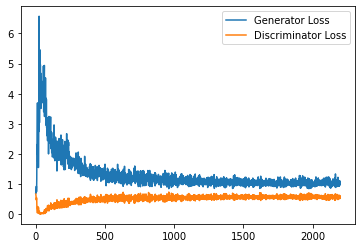

Step 44500: Generator loss: 1.052755427122116, discriminator loss: 0.5758222351670266


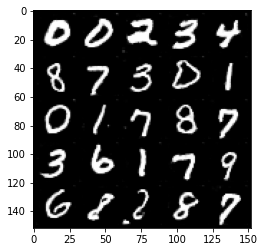

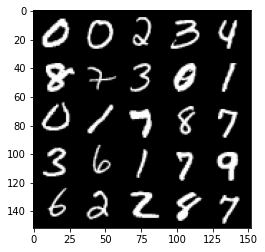

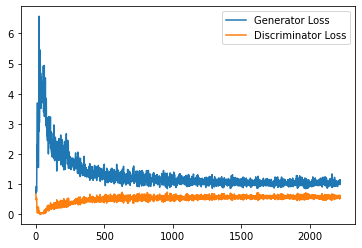

Step 45000: Generator loss: 1.0537668664455413, discriminator loss: 0.5754191034436226


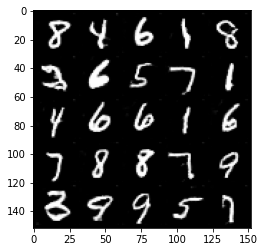

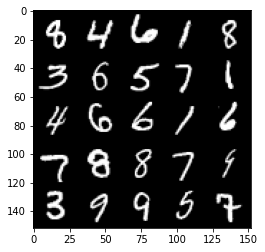

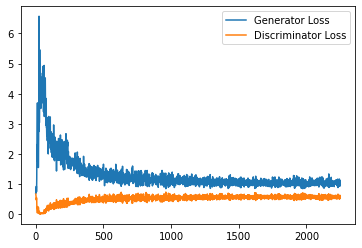

Step 45500: Generator loss: 1.0621560604572295, discriminator loss: 0.572109313249588


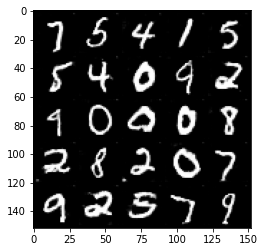

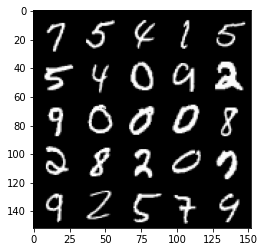

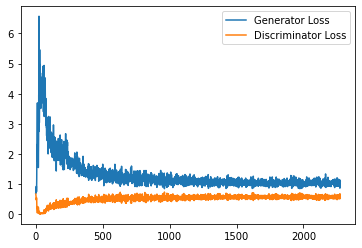

Step 46000: Generator loss: 1.0848751024007797, discriminator loss: 0.5744355765581131


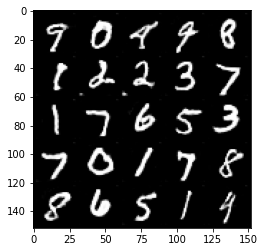

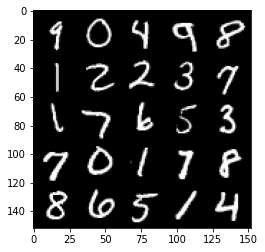

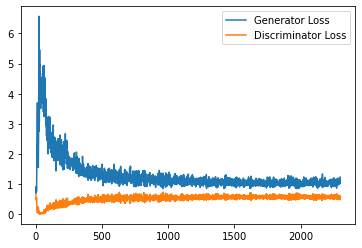

Step 46500: Generator loss: 1.0717823793888093, discriminator loss: 0.5759800848960877


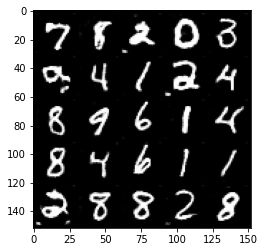

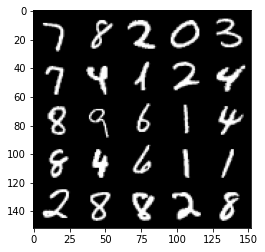

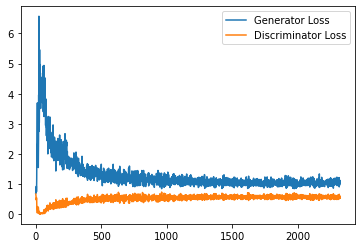

Step 47000: Generator loss: 1.0679462575912475, discriminator loss: 0.5779638132452964


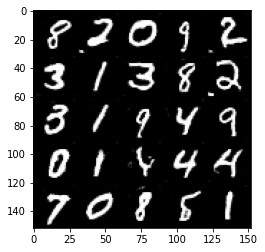

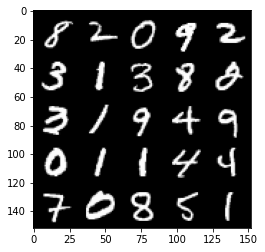

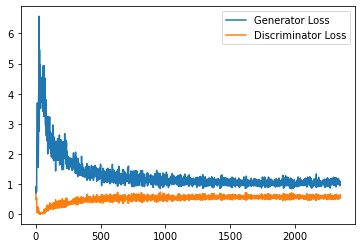

Step 47500: Generator loss: 1.0637149946689606, discriminator loss: 0.5712403335571289


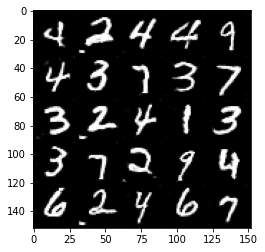

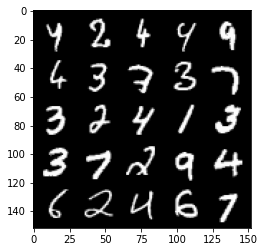

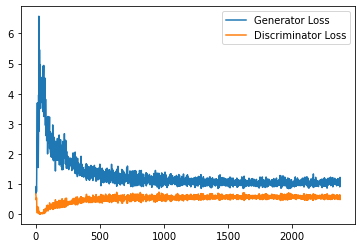

Step 48000: Generator loss: 1.0721854810714722, discriminator loss: 0.5687507669329643


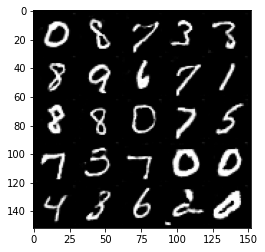

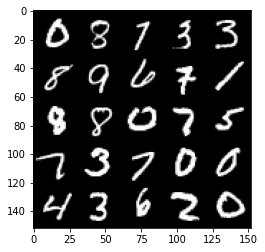

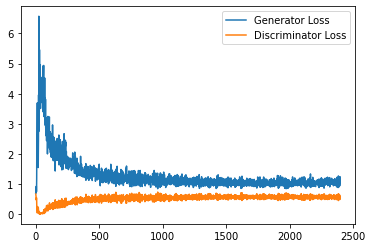

Step 48500: Generator loss: 1.0833478021621703, discriminator loss: 0.5677240902781486


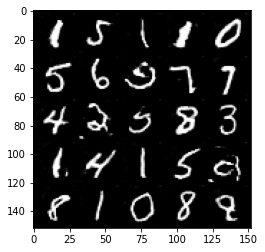

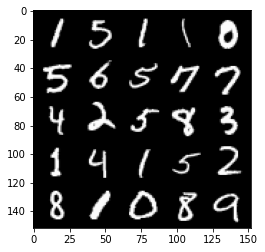

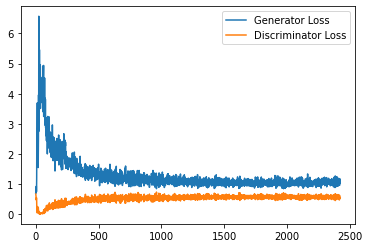

Step 49000: Generator loss: 1.0707951604127883, discriminator loss: 0.5683419731259346


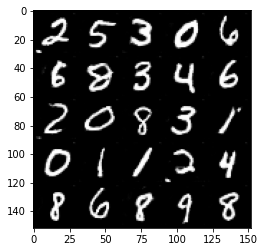

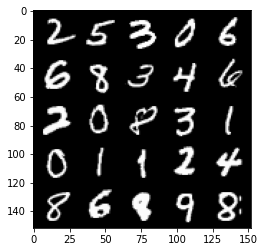

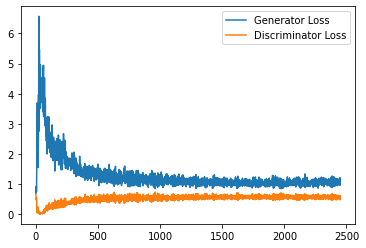

Step 49500: Generator loss: 1.0747765119075776, discriminator loss: 0.568125200331211


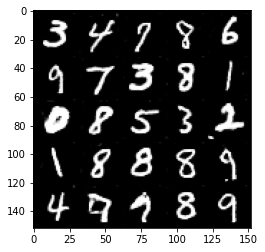

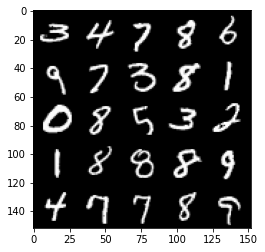

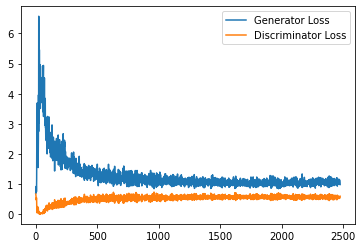

Step 50000: Generator loss: 1.058386177778244, discriminator loss: 0.5700788913369179


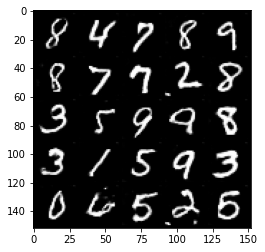

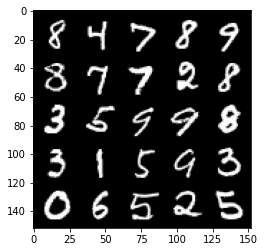

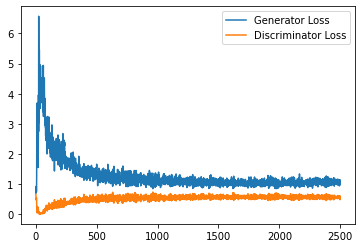

Step 50500: Generator loss: 1.0611532312631606, discriminator loss: 0.5647821072340011


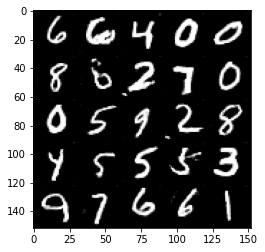

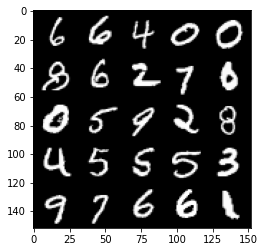

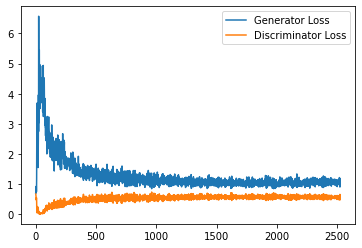

Step 51000: Generator loss: 1.0548174520730973, discriminator loss: 0.5701514524817467


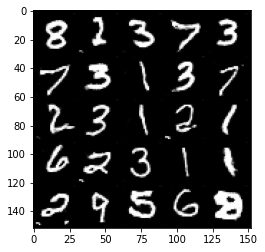

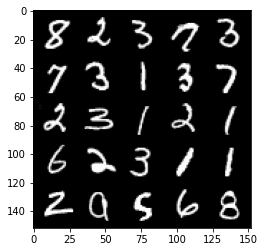

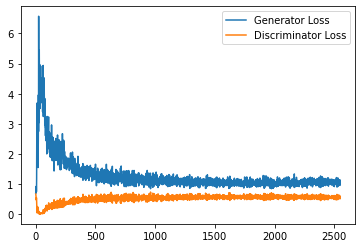

Step 51500: Generator loss: 1.08784947347641, discriminator loss: 0.5651106306314468


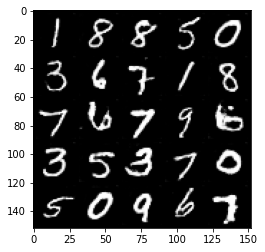

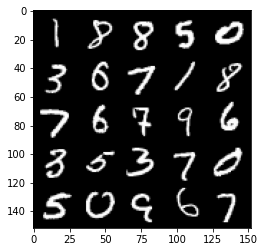

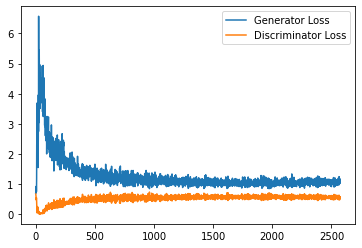

Step 52000: Generator loss: 1.1029574624300003, discriminator loss: 0.5617772856354714


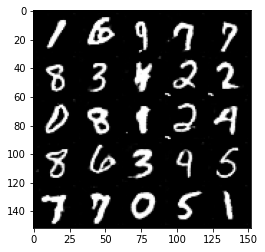

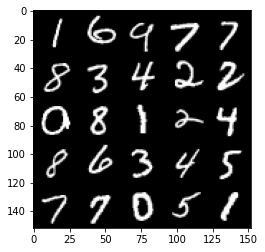

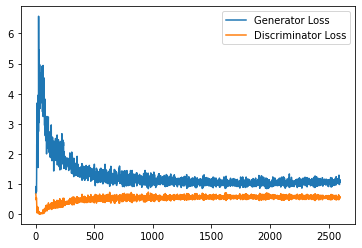

Step 52500: Generator loss: 1.0947741401195525, discriminator loss: 0.5608356838226318


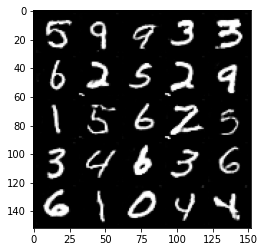

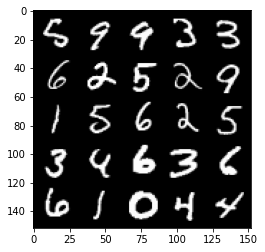

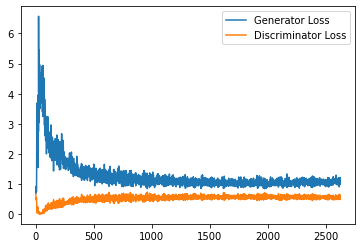

Step 53000: Generator loss: 1.0819345804452896, discriminator loss: 0.5694895124435425


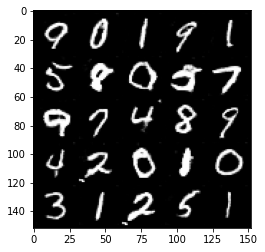

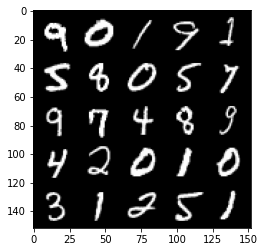

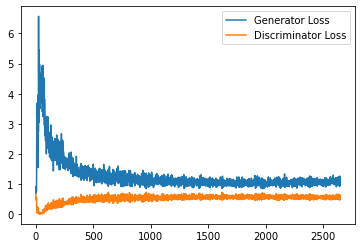

Step 53500: Generator loss: 1.0811556084156035, discriminator loss: 0.561468785226345


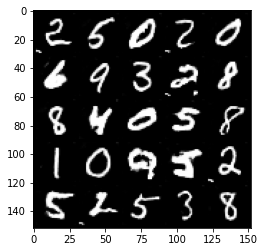

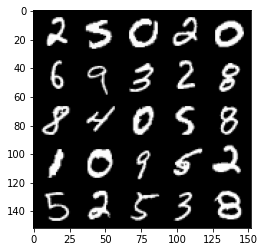

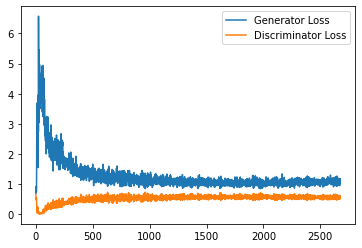

Step 54000: Generator loss: 1.0927859979867935, discriminator loss: 0.5639048509597778


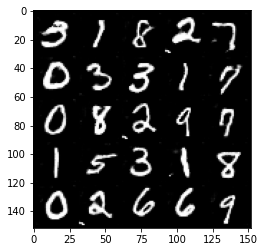

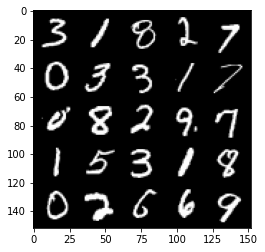

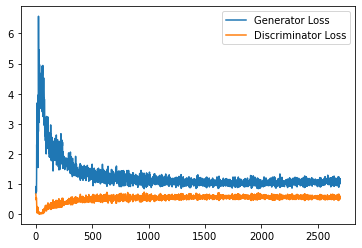

Step 54500: Generator loss: 1.0951064137220383, discriminator loss: 0.5643063618540763


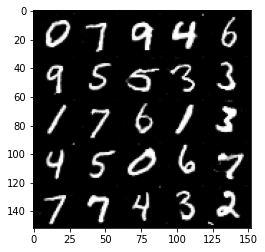

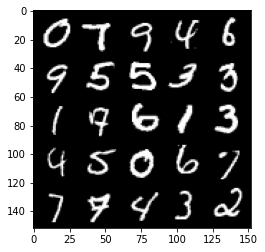

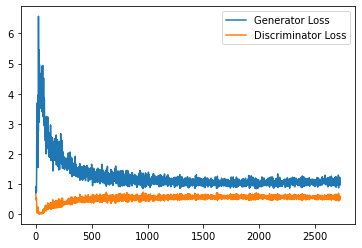

Step 55000: Generator loss: 1.0855088458061217, discriminator loss: 0.5619160992503166


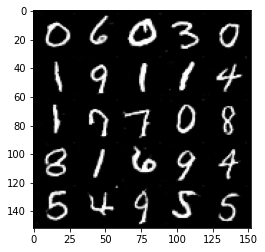

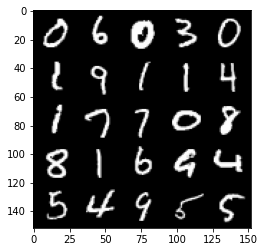

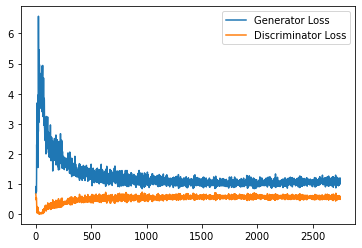

Step 55500: Generator loss: 1.1023086725473403, discriminator loss: 0.5541536893248558


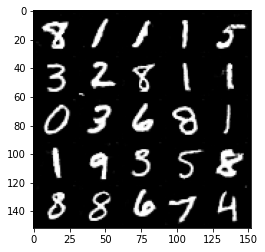

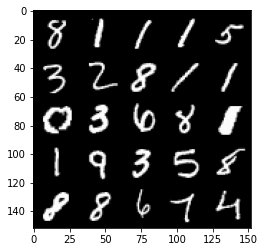

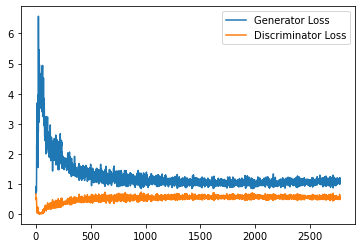

Step 56000: Generator loss: 1.0927975803613663, discriminator loss: 0.5567191582918167


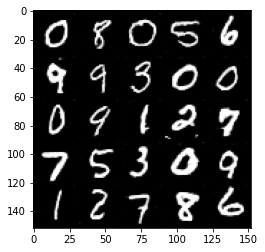

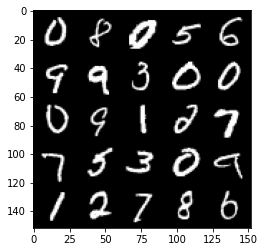

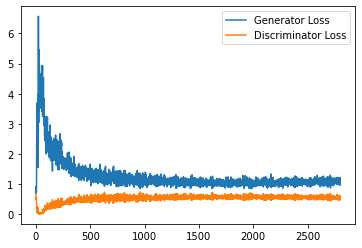

Step 56500: Generator loss: 1.129077480316162, discriminator loss: 0.559761897444725


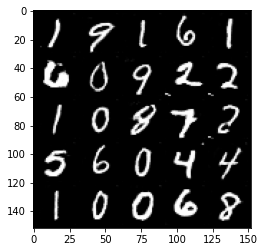

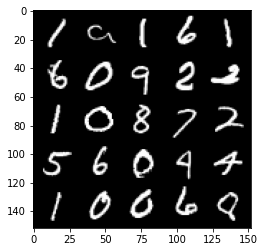

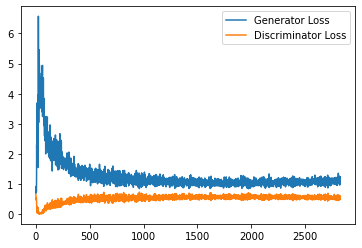

Step 57000: Generator loss: 1.0756515015363692, discriminator loss: 0.5604979895949364


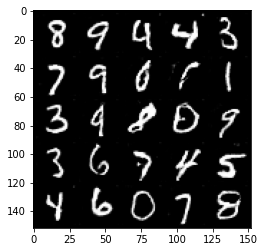

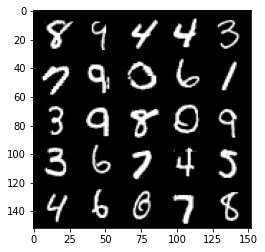

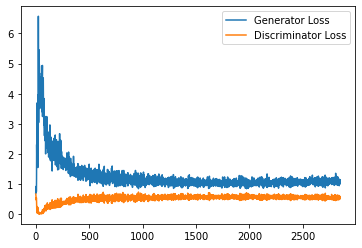

Step 57500: Generator loss: 1.111031686067581, discriminator loss: 0.550158416390419


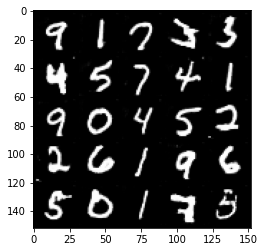

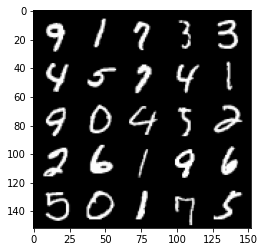

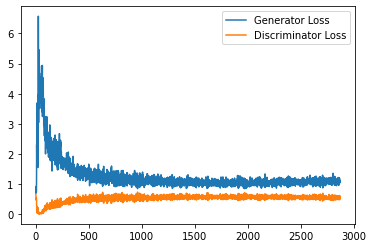

Step 58000: Generator loss: 1.0757272027730942, discriminator loss: 0.556794558763504


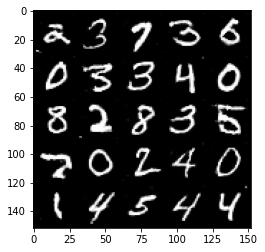

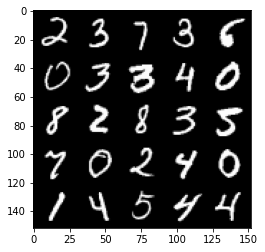

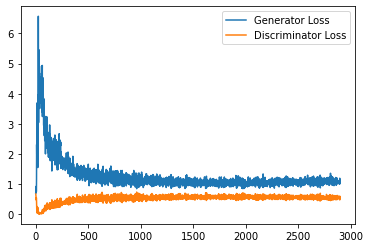

Step 58500: Generator loss: 1.1004409765005112, discriminator loss: 0.5536794318556786


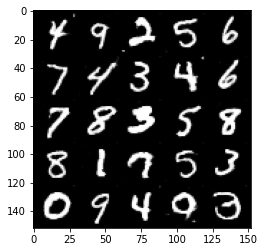

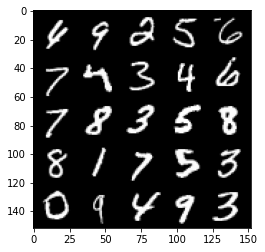

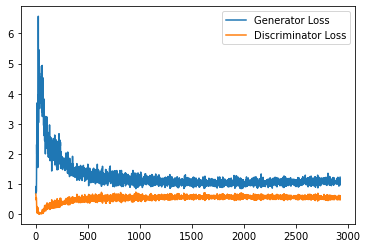

Step 59000: Generator loss: 1.0966480449438094, discriminator loss: 0.5548066643476486


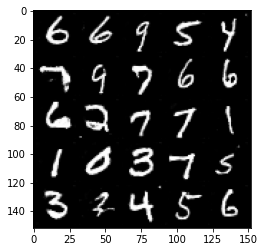

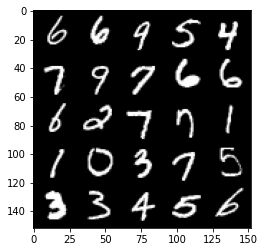

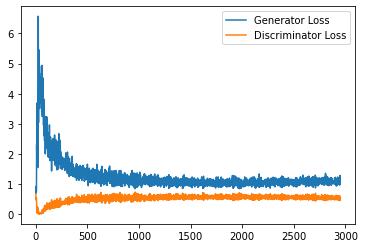

Step 59500: Generator loss: 1.1171894220113754, discriminator loss: 0.5529629101753235


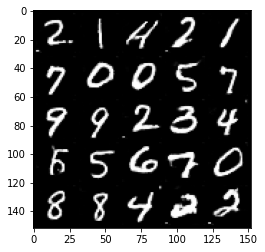

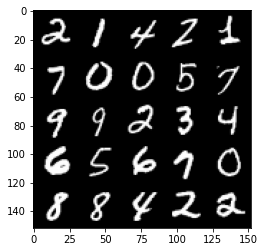

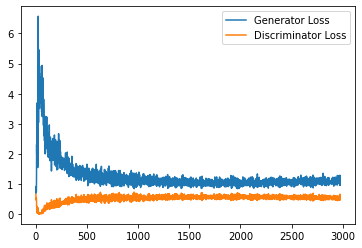

Step 60000: Generator loss: 1.1399334868192672, discriminator loss: 0.5537049060463906


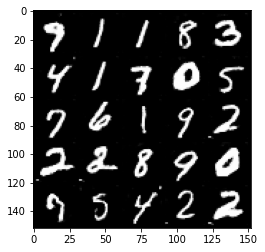

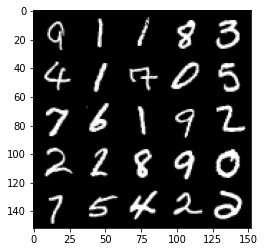

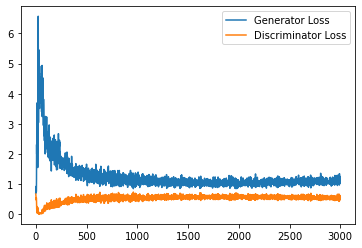

Step 60500: Generator loss: 1.125111840724945, discriminator loss: 0.5542510830163956


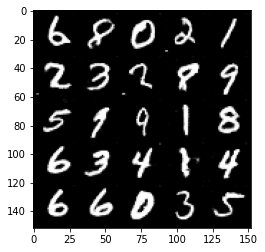

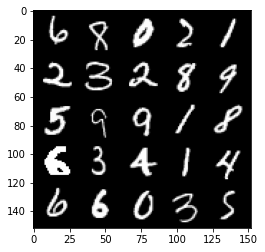

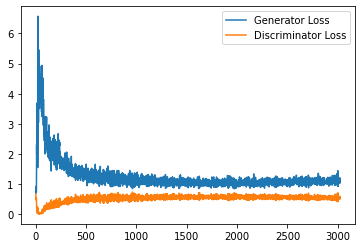

Step 61000: Generator loss: 1.118302649140358, discriminator loss: 0.5558709193468094


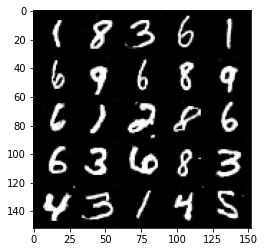

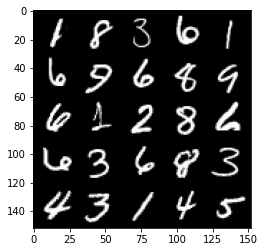

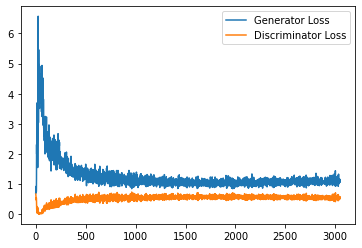

Step 61500: Generator loss: 1.1051890256404877, discriminator loss: 0.554061223089695


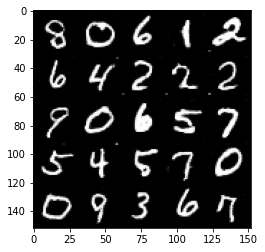

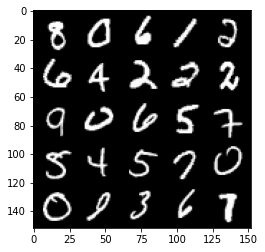

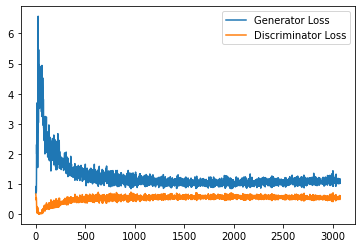

Step 62000: Generator loss: 1.1407410575151444, discriminator loss: 0.5476515805125236


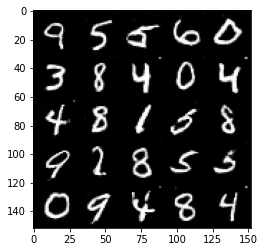

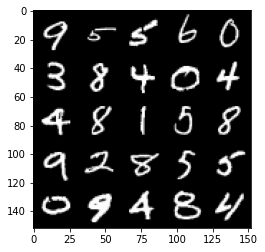

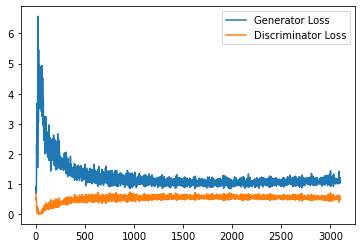

Step 62500: Generator loss: 1.1392874324321747, discriminator loss: 0.5474015021324158


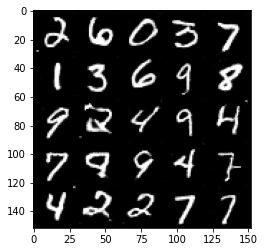

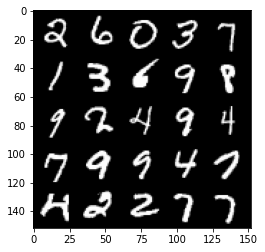

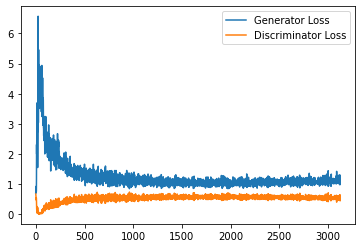

Step 63000: Generator loss: 1.1151055488586425, discriminator loss: 0.552888501226902


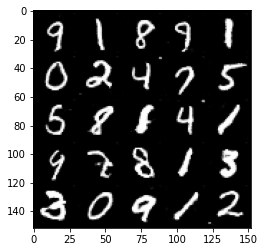

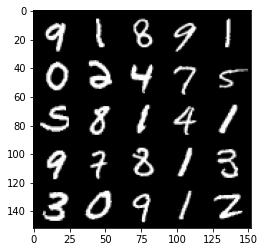

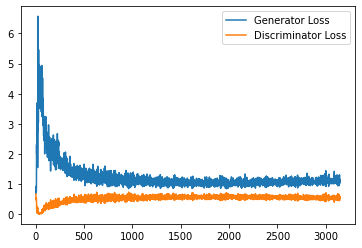

Step 63500: Generator loss: 1.1157533110380173, discriminator loss: 0.5476789663434029


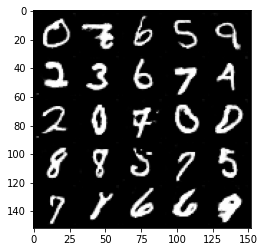

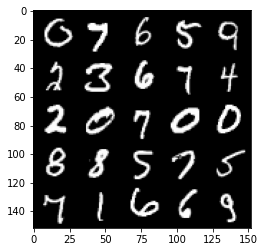

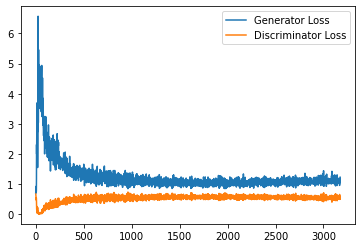

Step 64000: Generator loss: 1.1486920082569123, discriminator loss: 0.5476098355650901


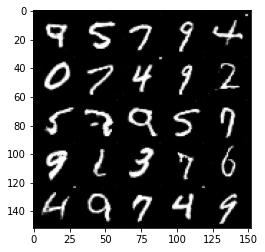

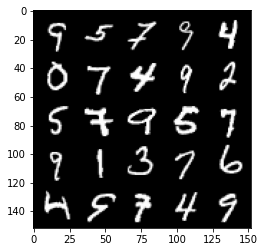

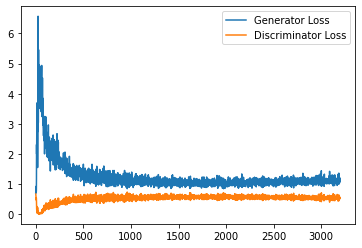

Step 64500: Generator loss: 1.1291993237733842, discriminator loss: 0.5476950447559357


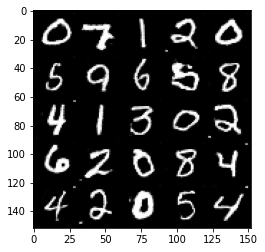

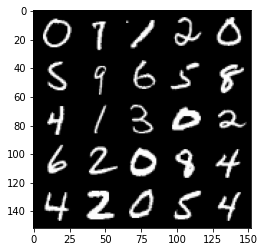

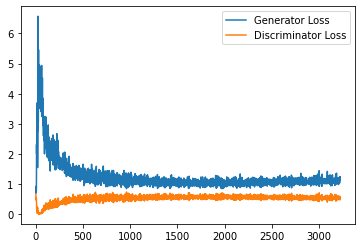

Step 65000: Generator loss: 1.1347696466445922, discriminator loss: 0.5430017772316933


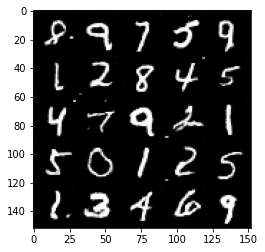

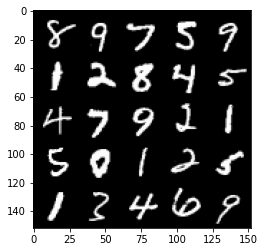

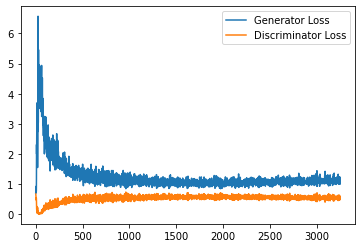

Step 65500: Generator loss: 1.1311919896602631, discriminator loss: 0.5437190734148025


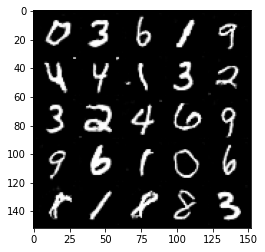

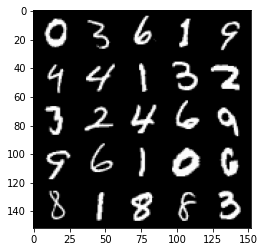

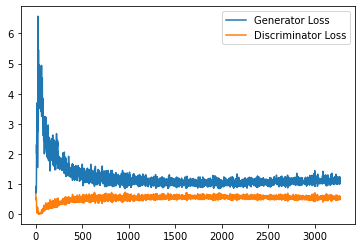

Step 66000: Generator loss: 1.1284050555229188, discriminator loss: 0.5412971197366715


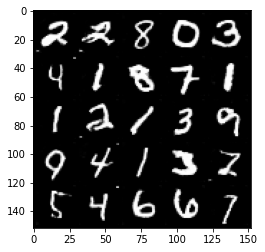

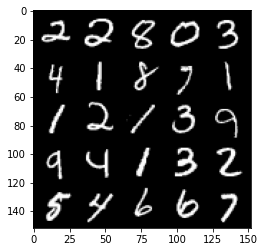

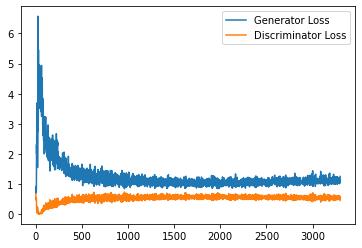

Step 66500: Generator loss: 1.1220059479475022, discriminator loss: 0.5441782437562942


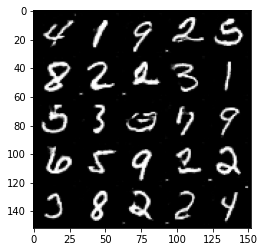

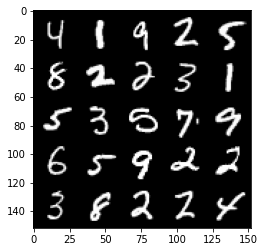

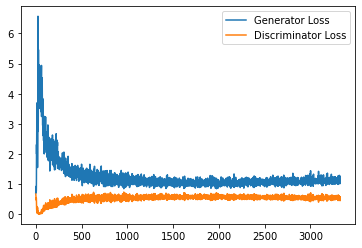

Step 67000: Generator loss: 1.1395605692863464, discriminator loss: 0.5424381127953529


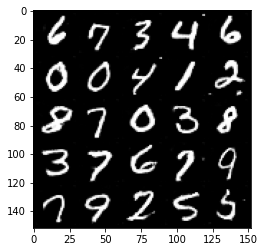

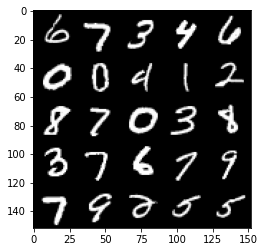

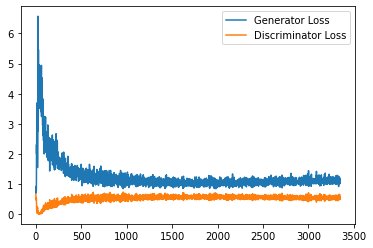

Step 67500: Generator loss: 1.1305155735015868, discriminator loss: 0.5418602187037468


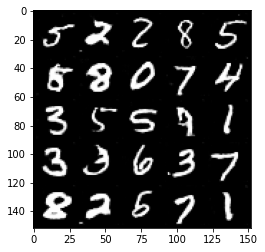

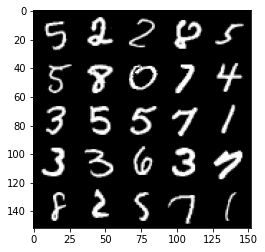

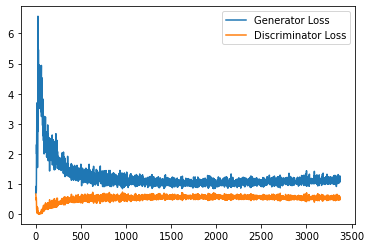

Step 68000: Generator loss: 1.1424521899223328, discriminator loss: 0.5352852692008019


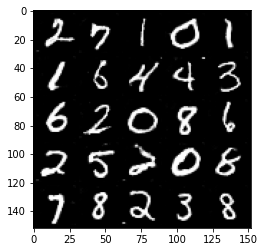

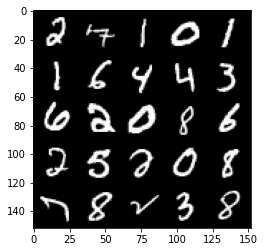

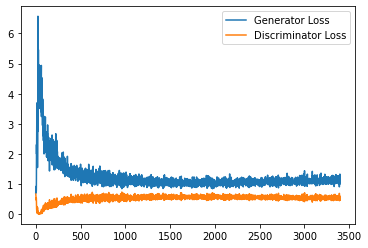

Step 68500: Generator loss: 1.1380335550308227, discriminator loss: 0.5386858491897583


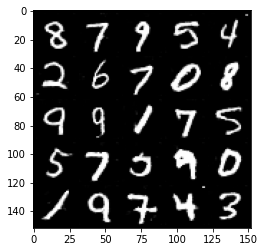

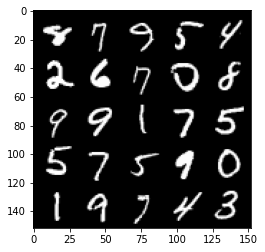

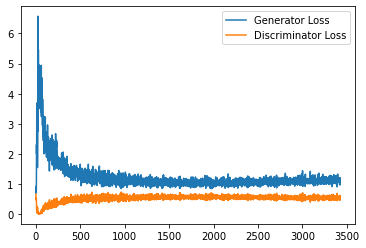

Step 69000: Generator loss: 1.1519277688264846, discriminator loss: 0.5391777941584587


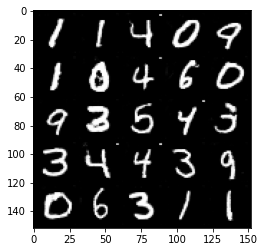

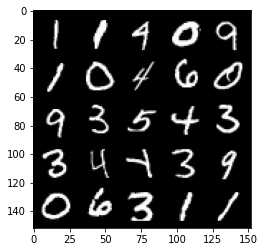

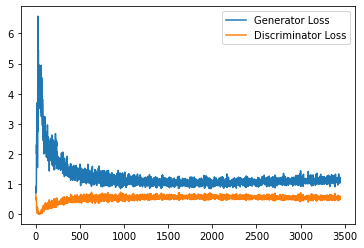

Step 69500: Generator loss: 1.149567290186882, discriminator loss: 0.5324741846323013


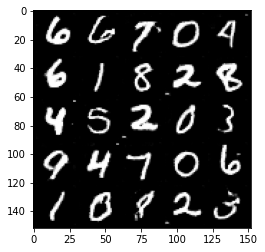

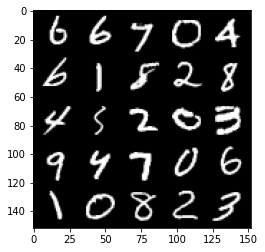

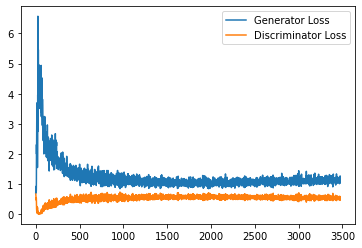

Step 70000: Generator loss: 1.1648094086647034, discriminator loss: 0.5433857557177544


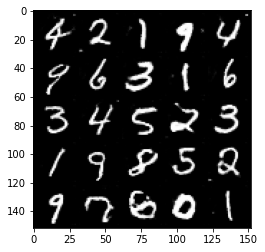

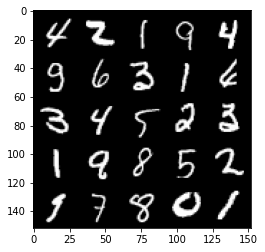

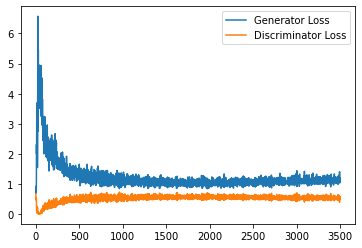

Step 70500: Generator loss: 1.1378577305078506, discriminator loss: 0.5420693049430847


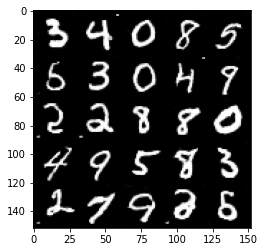

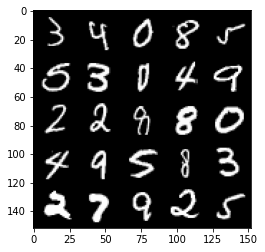

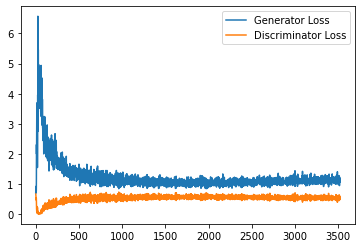

Step 71000: Generator loss: 1.1533544099330901, discriminator loss: 0.5357234101295472


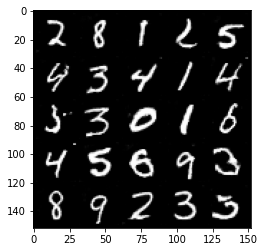

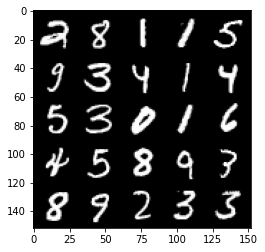

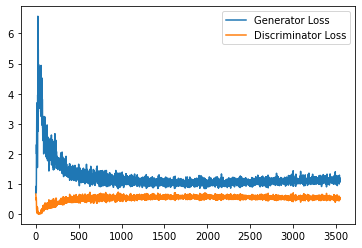

Step 71500: Generator loss: 1.1533530222177506, discriminator loss: 0.5360061795711517


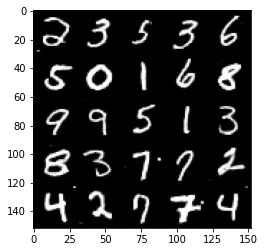

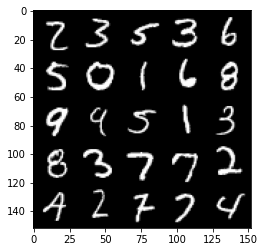

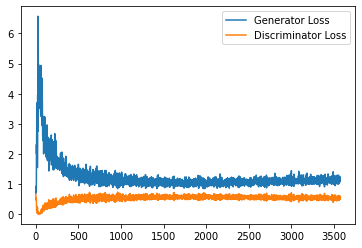

Step 72000: Generator loss: 1.1558920185565948, discriminator loss: 0.5365758321881294


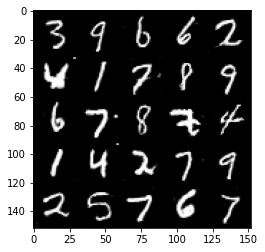

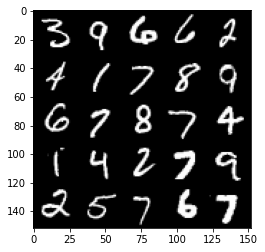

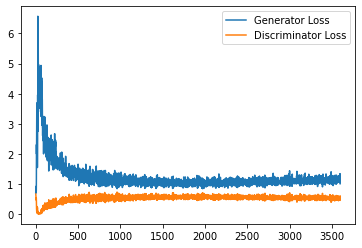

Step 72500: Generator loss: 1.1802934865951538, discriminator loss: 0.5341831934452057


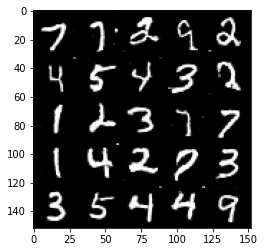

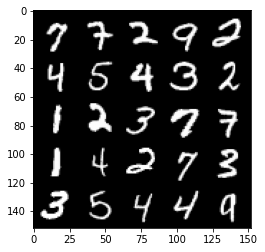

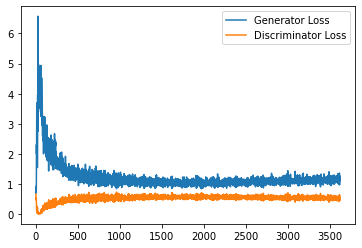

Step 73000: Generator loss: 1.164815396666527, discriminator loss: 0.5334045110940934


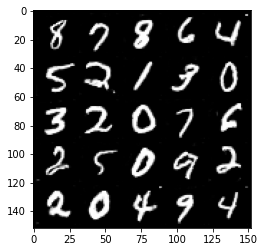

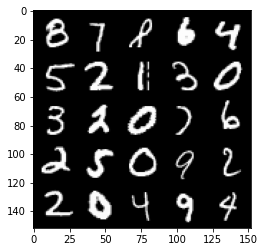

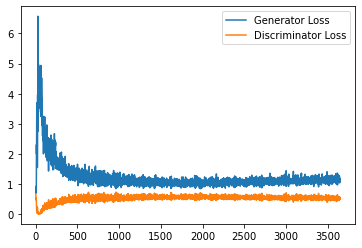

Step 73500: Generator loss: 1.1524542834758758, discriminator loss: 0.5314648494124412


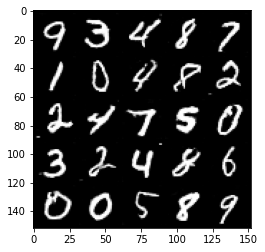

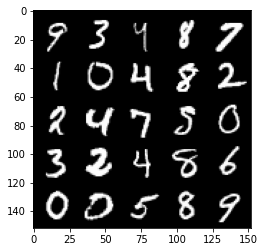

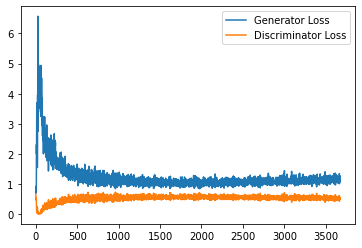

Step 74000: Generator loss: 1.1794435245990753, discriminator loss: 0.5307600451111794


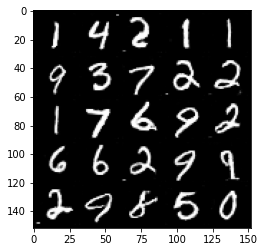

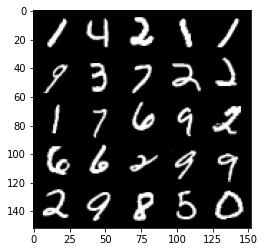

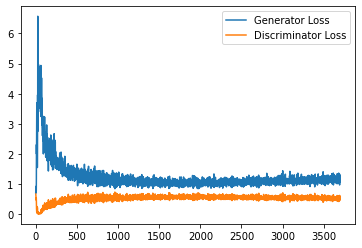

Step 74500: Generator loss: 1.1742088499069214, discriminator loss: 0.5342970862984657


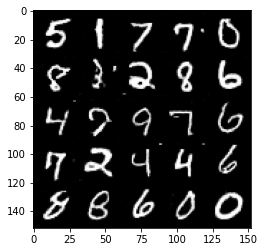

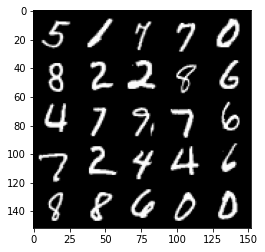

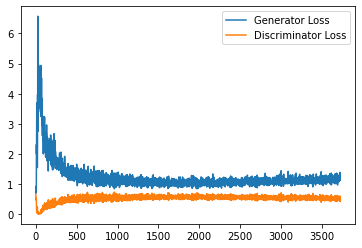

Step 75000: Generator loss: 1.1545528204441071, discriminator loss: 0.5341728093624115


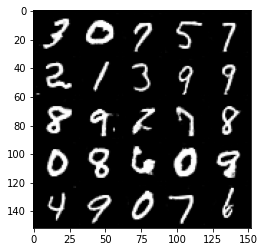

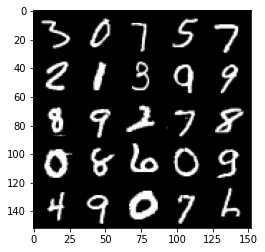

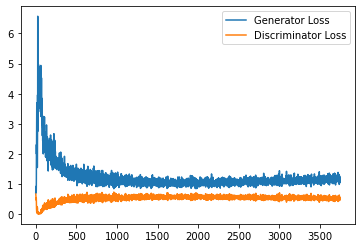

Step 75500: Generator loss: 1.1584952394962311, discriminator loss: 0.5316710611581802


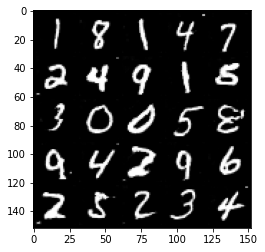

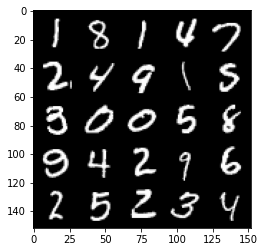

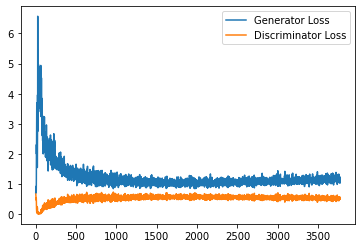

Step 76000: Generator loss: 1.165203733563423, discriminator loss: 0.5303684823513031


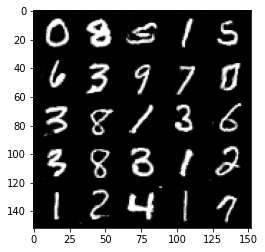

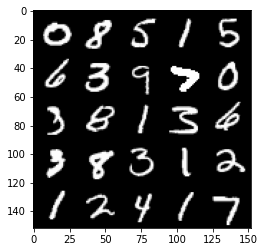

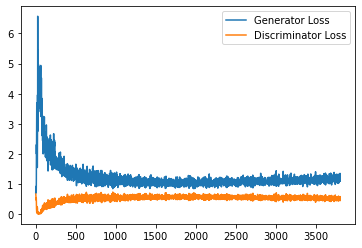

Step 76500: Generator loss: 1.1861628960371018, discriminator loss: 0.5381004400253296


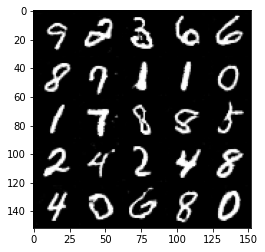

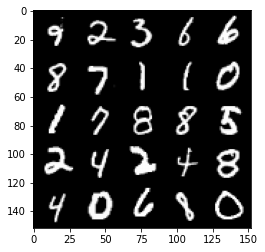

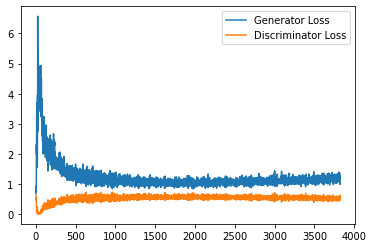

Step 77000: Generator loss: 1.1780083470344545, discriminator loss: 0.5322431455254555


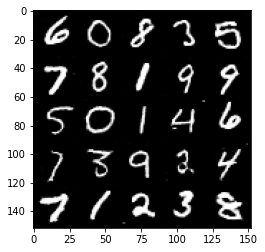

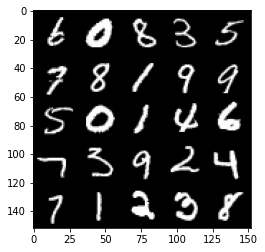

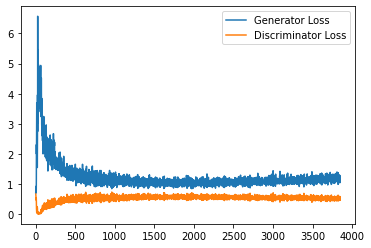

Step 77500: Generator loss: 1.1637156828641892, discriminator loss: 0.5349898396134376


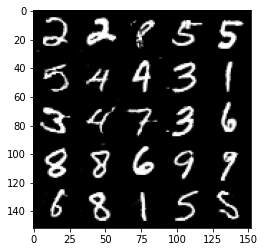

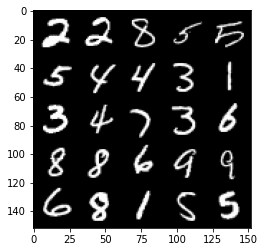

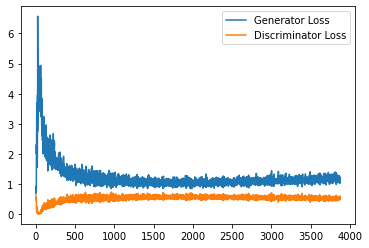

Step 78000: Generator loss: 1.167634244799614, discriminator loss: 0.5315739866495133


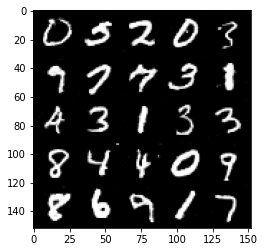

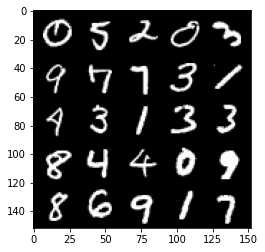

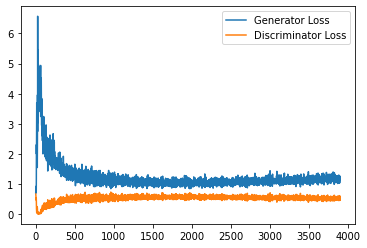

Step 78500: Generator loss: 1.1702888346910476, discriminator loss: 0.5298272881507874


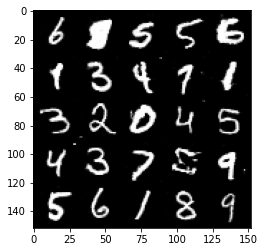

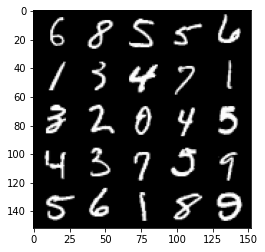

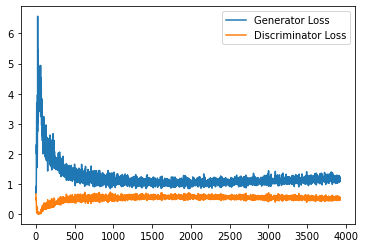

Step 79000: Generator loss: 1.1903542726039886, discriminator loss: 0.5302378346323967


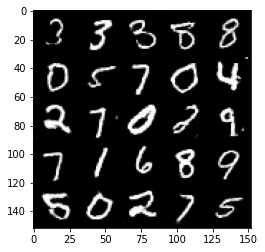

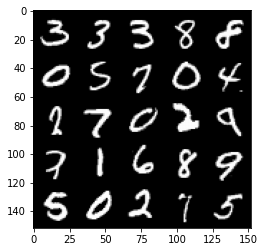

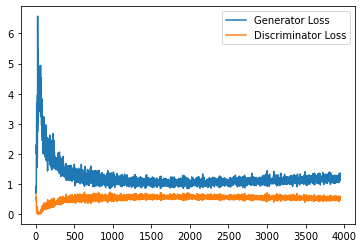

Step 79500: Generator loss: 1.184857892036438, discriminator loss: 0.5360916712284088


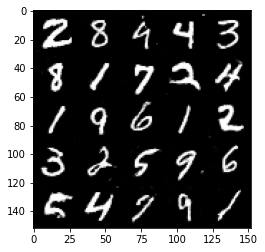

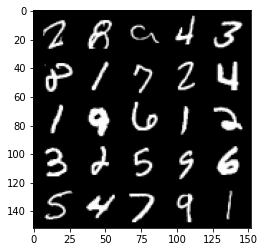

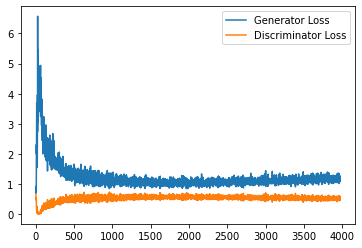

Step 80000: Generator loss: 1.1897307447195054, discriminator loss: 0.5259782260656357


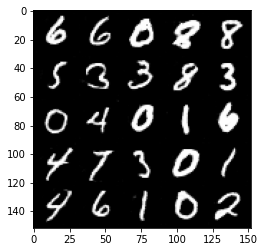

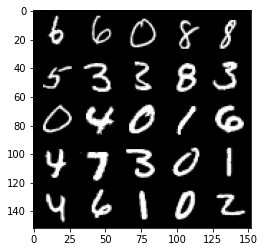

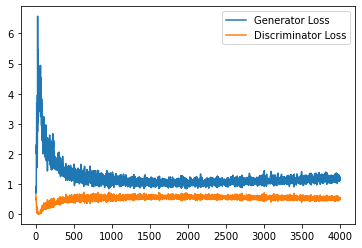

Step 80500: Generator loss: 1.1770401639938355, discriminator loss: 0.5309791539311409


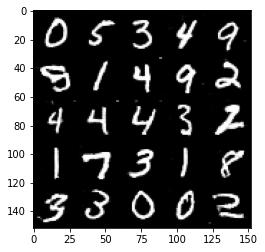

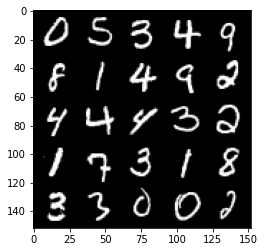

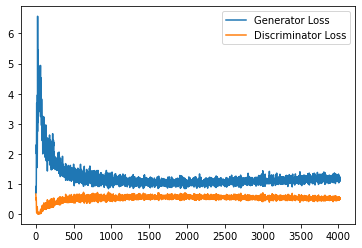

Step 81000: Generator loss: 1.1906419405937194, discriminator loss: 0.5318362926244735


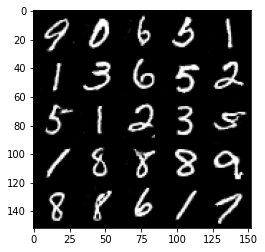

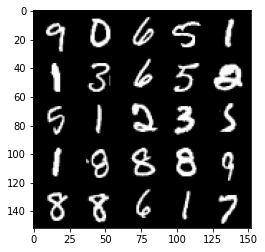

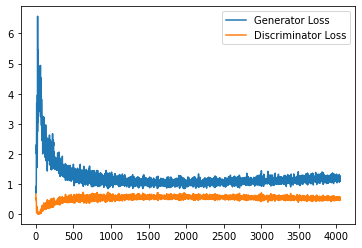

Step 81500: Generator loss: 1.1753847053050994, discriminator loss: 0.5319049819111824


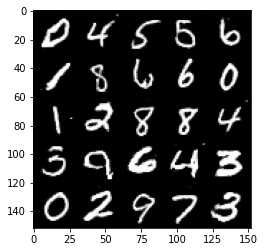

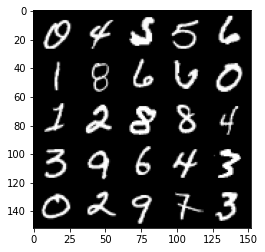

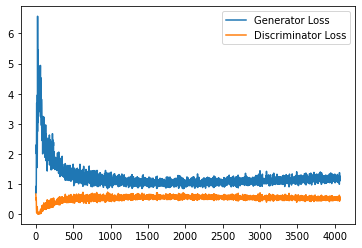

Step 82000: Generator loss: 1.1944501762390136, discriminator loss: 0.5324524856805801


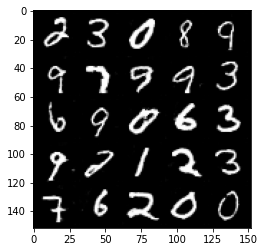

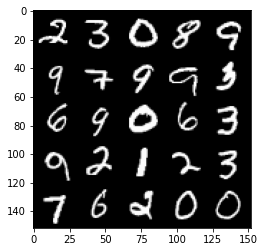

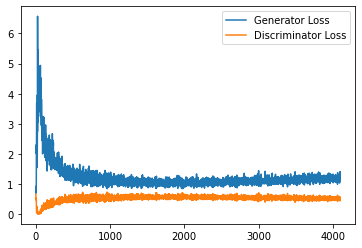

Step 82500: Generator loss: 1.183341022849083, discriminator loss: 0.5351704946160316


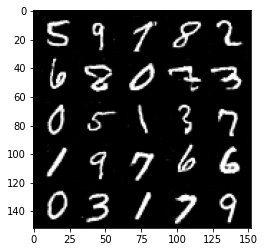

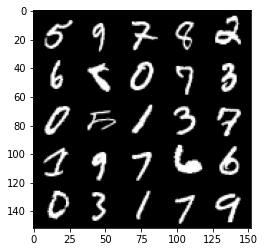

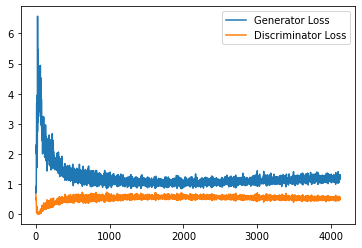

Step 83000: Generator loss: 1.1700863716602325, discriminator loss: 0.5354467988610268


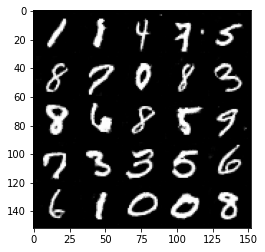

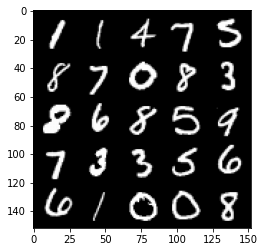

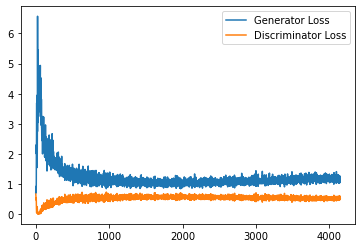

Step 83500: Generator loss: 1.1702987382411956, discriminator loss: 0.5337615838646889


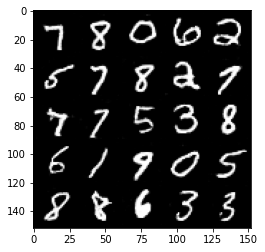

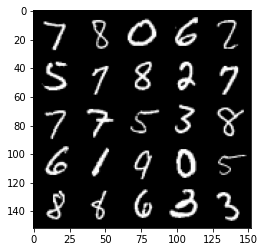

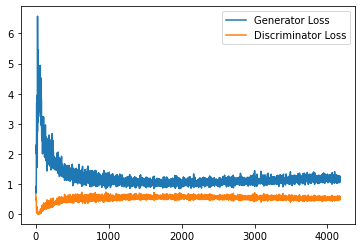

Step 84000: Generator loss: 1.1825548849105836, discriminator loss: 0.5303374030590058


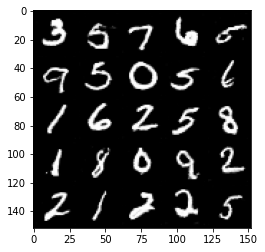

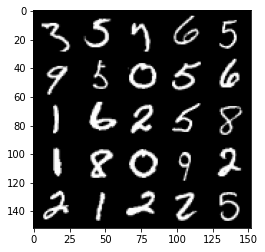

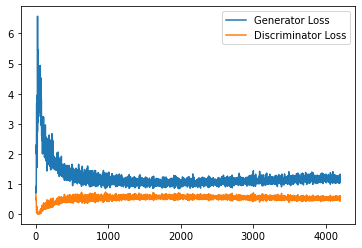

Step 84500: Generator loss: 1.1792477383613587, discriminator loss: 0.5330997906327247


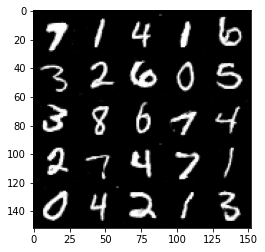

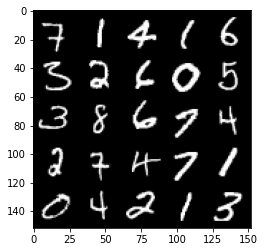

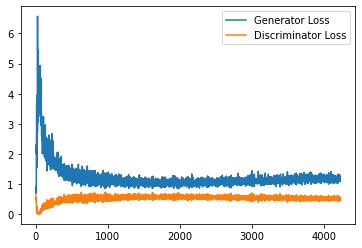

Step 85000: Generator loss: 1.1703631343841552, discriminator loss: 0.5302908263206482


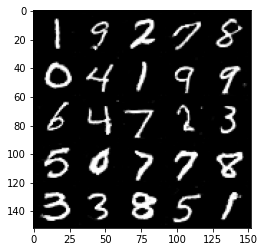

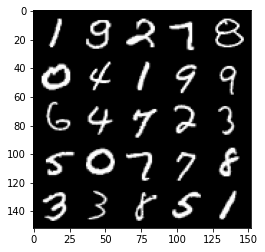

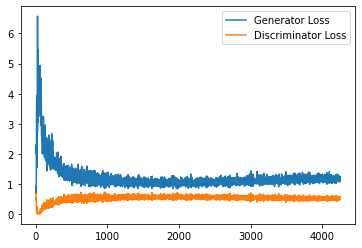

Step 85500: Generator loss: 1.1896177126169205, discriminator loss: 0.5335080687403679


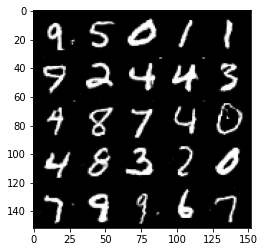

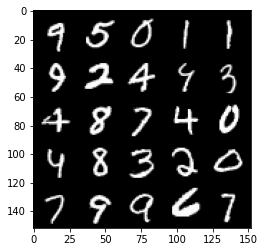

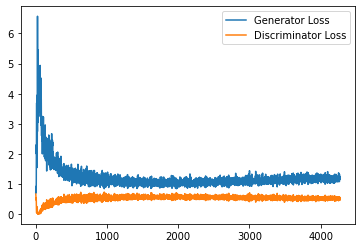

Step 86000: Generator loss: 1.190864462018013, discriminator loss: 0.5299479495882988


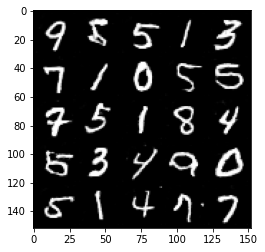

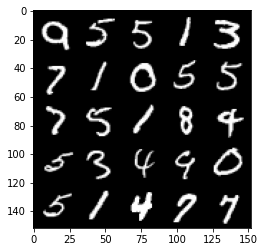

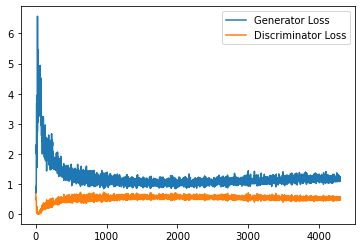

Step 86500: Generator loss: 1.1852457263469696, discriminator loss: 0.5325154283046722


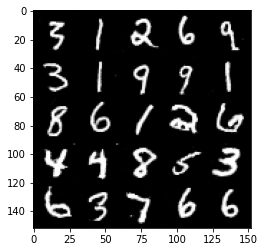

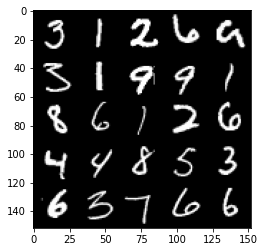

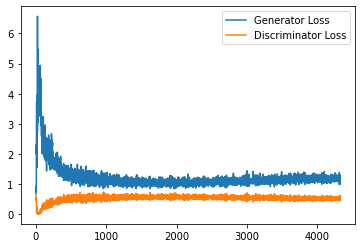

Step 87000: Generator loss: 1.1942123777866362, discriminator loss: 0.5282886878848075


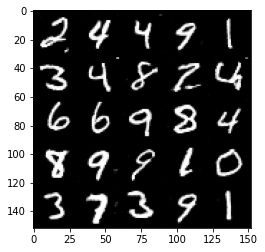

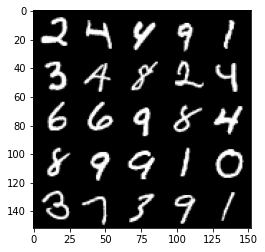

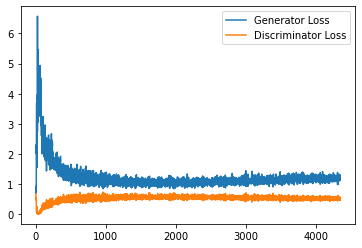

Step 87500: Generator loss: 1.1794635791778565, discriminator loss: 0.5351542414426803


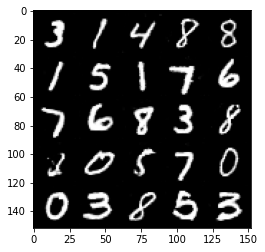

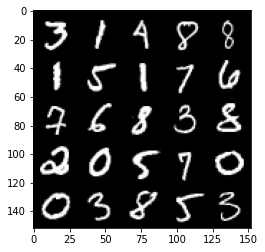

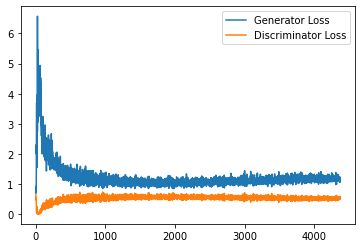

Step 88000: Generator loss: 1.1922422553300858, discriminator loss: 0.5276546765565873


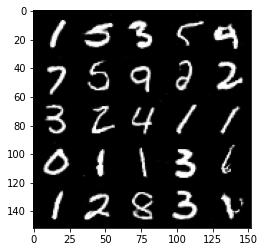

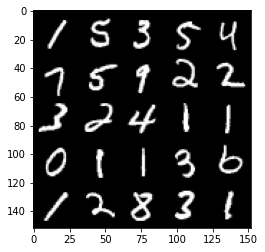

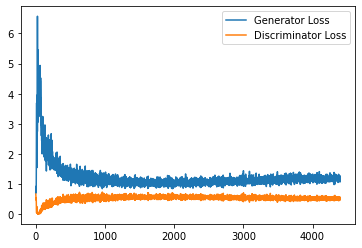

Step 88500: Generator loss: 1.1874692435264587, discriminator loss: 0.5326811353564262


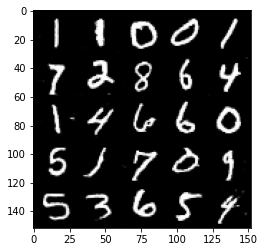

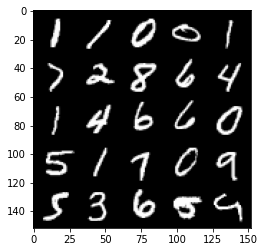

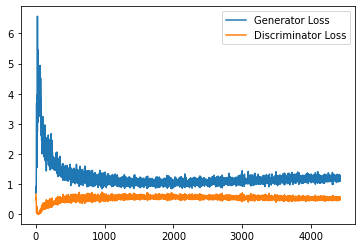

Step 89000: Generator loss: 1.1863597785234452, discriminator loss: 0.5276252245306968


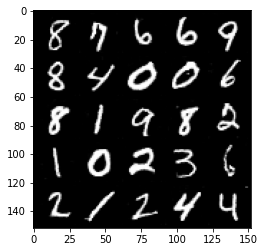

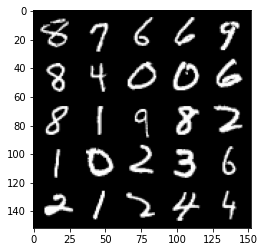

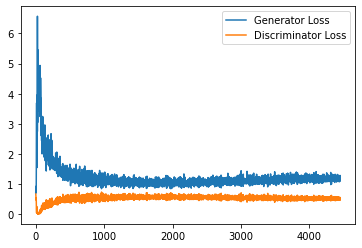

Step 89500: Generator loss: 1.2144386787414552, discriminator loss: 0.5320592955946922


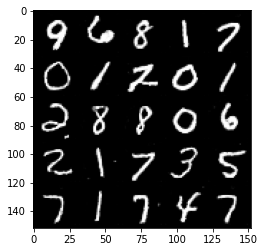

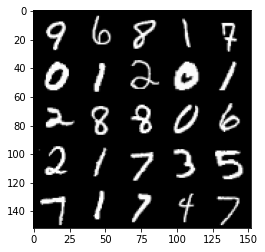

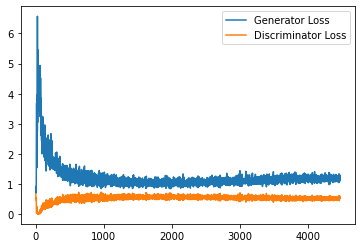

Step 90000: Generator loss: 1.1866904990673066, discriminator loss: 0.5296160661578179


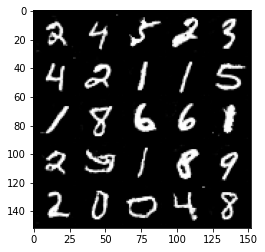

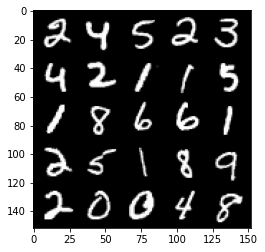

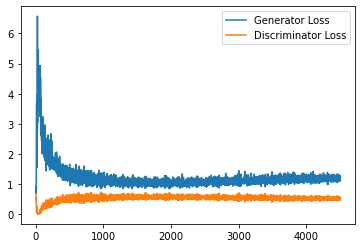

Step 90500: Generator loss: 1.2022070795297624, discriminator loss: 0.533157883822918


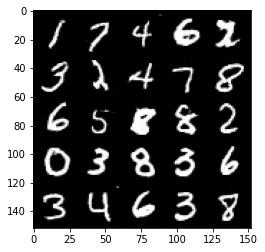

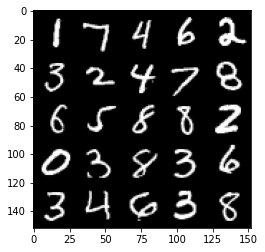

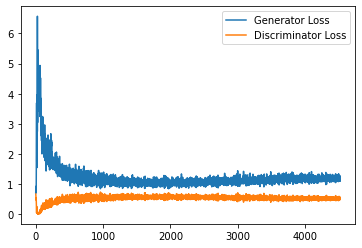

Step 91000: Generator loss: 1.1892842926979066, discriminator loss: 0.5269230690002441


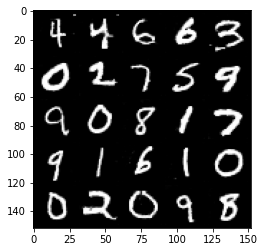

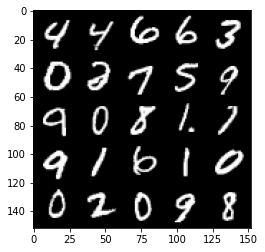

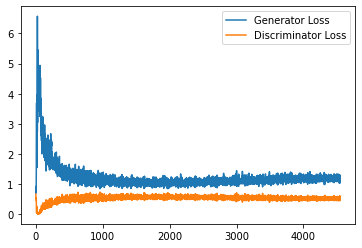

Step 91500: Generator loss: 1.1997916165590286, discriminator loss: 0.5306081442832947


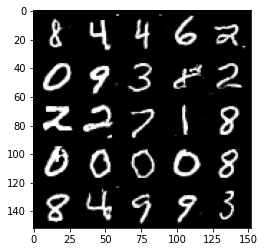

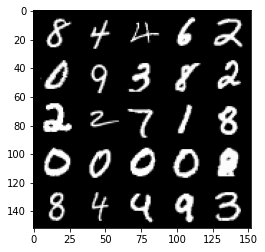

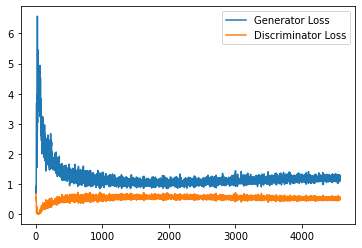

Step 92000: Generator loss: 1.1941694847345352, discriminator loss: 0.5275355682373047


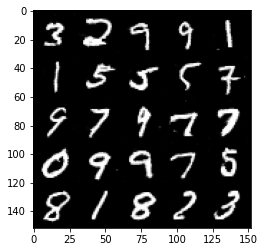

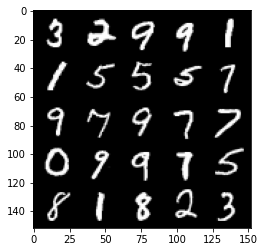

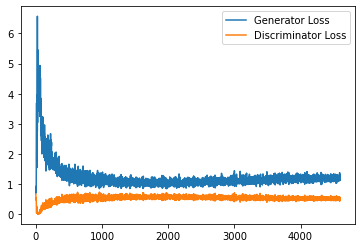

Step 92500: Generator loss: 1.218262002825737, discriminator loss: 0.5294902859926224


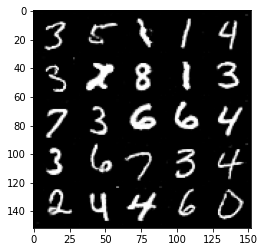

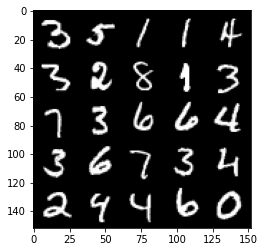

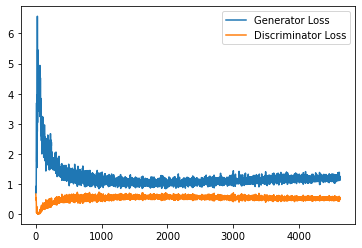

Step 93000: Generator loss: 1.205260888338089, discriminator loss: 0.5296654155254364


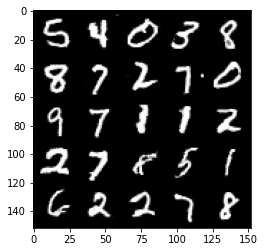

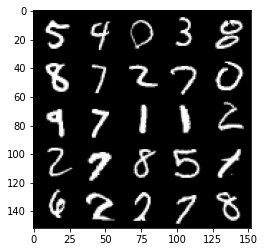

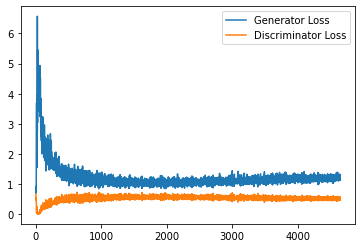

Step 93500: Generator loss: 1.1991923804283142, discriminator loss: 0.5288087195754051


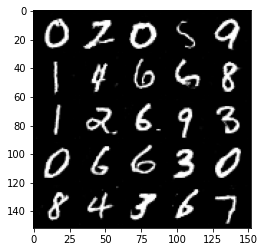

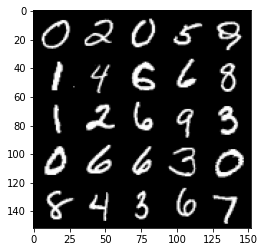

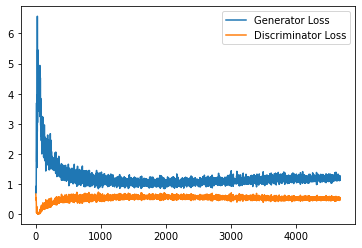

In [32]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise,one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake,image_one_hot_labels)
        real_image_and_labels = combine_vectors(real,image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [ ]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

In [ ]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

In [ ]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()